# Example Notebook (Adult Census Income Dataset)

In [1]:
import os
import xai
import logging as log 
import warnings
import matplotlib.pyplot as plt
from matplotlib import cm
import sys, os
from util.commons import *
from util.ui import *
from util.model import *
from util.split import *
from util.dataset import *
from IPython.display import display, HTML

## Load a dataset
For this example we are going to use 'Adult Census Dataset'. It consists of both categorical and numerical features.

In [2]:
dataset, msg = get_dataset('census')
display(msg)
display(dataset.df)

"Dataset 'census (Adult census dataset)' loaded successfully. For further information about this dataset please visit: https://ethicalml.github.io/xai/index.html?highlight=load_census#xai.data.load_census"

,age,workclass,education,education-num,marital-status,occupation,relationship,ethnicity,gender,capital-gain,capital-loss,hours-per-week,loan
0,39,State-gov,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,<=50K
1,50,Self-emp-not-inc,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,<=50K
2,38,Private,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,<=50K
3,53,Private,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,<=50K
4,28,Private,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27,Private,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,<=50K
32557,40,Private,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,>50K
32558,58,Private,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,<=50K
32559,22,Private,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,<=50K


## Preprocess the dataset
There are values in the dataset that are unknown (*\?*). In this step all rows containing such values are going to be removed. 

In [3]:
dataset.df['workclass'].unique()

array([' State-gov', ' Self-emp-not-inc', ' Private', ' Federal-gov',
       ' Local-gov', ' ?', ' Self-emp-inc', ' Without-pay',
       ' Never-worked'], dtype=object)

In [4]:
dataset.df.loc[dataset.df['workclass'] == ' ?']

,age,workclass,education,education-num,marital-status,occupation,relationship,ethnicity,gender,capital-gain,capital-loss,hours-per-week,loan
27,54,?,Some-college,10,Married-civ-spouse,?,Husband,Asian-Pac-Islander,Male,0,0,60,>50K
61,32,?,7th-8th,4,Married-spouse-absent,?,Not-in-family,White,Male,0,0,40,<=50K
69,25,?,Some-college,10,Never-married,?,Own-child,White,Male,0,0,40,<=50K
77,67,?,10th,6,Married-civ-spouse,?,Husband,White,Male,0,0,2,<=50K
106,17,?,10th,6,Never-married,?,Own-child,White,Female,34095,0,32,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...
32530,35,?,Bachelors,13,Married-civ-spouse,?,Wife,White,Female,0,0,55,>50K
32531,30,?,Bachelors,13,Never-married,?,Not-in-family,Asian-Pac-Islander,Female,0,0,99,<=50K
32539,71,?,Doctorate,16,Married-civ-spouse,?,Husband,White,Male,0,0,10,>50K
32541,41,?,HS-grad,9,Separated,?,Not-in-family,Black,Female,0,0,32,<=50K


In [5]:
dataset.df = remove_undefined_rows(' ?', dataset.df)
dataset.df['workclass'].unique()

array([' State-gov', ' Self-emp-not-inc', ' Private', ' Federal-gov',
       ' Local-gov', ' Self-emp-inc', ' Without-pay'], dtype=object)

## Visualize the dataset
Three visualization functions offered by the [XAI](https://github.com/EthicalML/XAI) module will be used for analyzing the dataset.
* The first one shows the imbalances of selected features. In the first plot below, for example, we can see that the majority of samples (people) are *white* *male* (gender='Male', ethnicity='White').
* The second and third plots show correlations between the features. The second one plots the correlations as a matrix, whereas the third one as a hierarchical dendogram.

07-May-23 23:59:24 - No categorical_cols passed so inferred using np.object, np.int8 and np.bool: Index(['workclass', 'education', 'marital-status', 'occupation',
       'relationship', 'ethnicity', 'gender', 'loan'],
      dtype='object'). If you see an error these are not correct, please provide them as a string array as: categorical_cols=['col1', 'col2', ...]


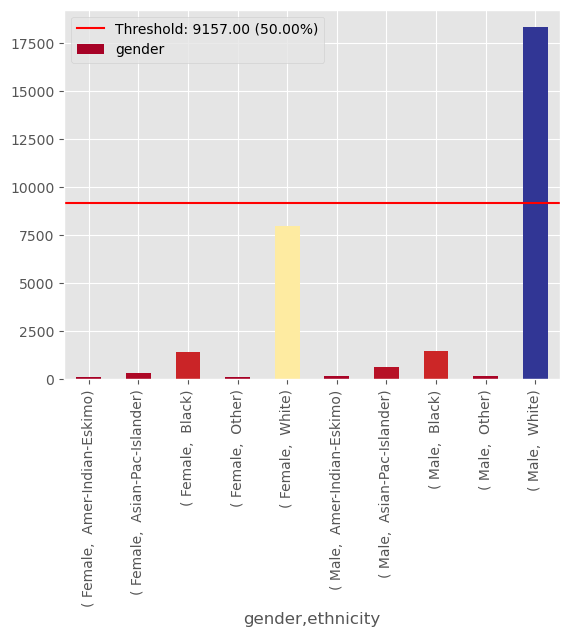

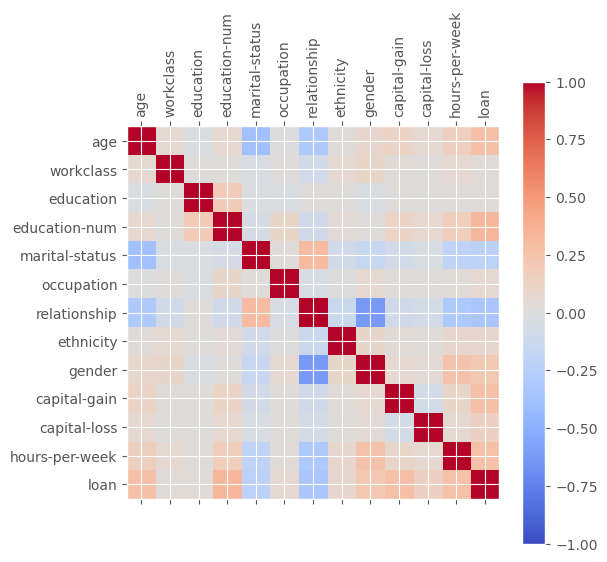

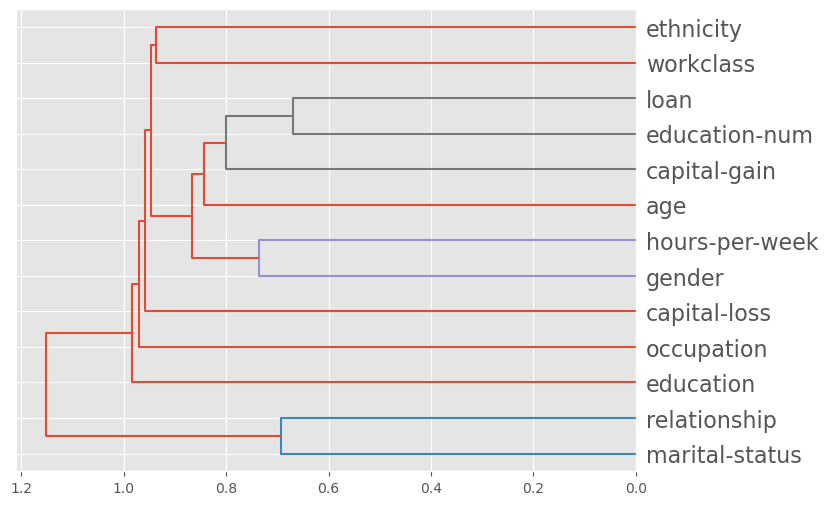

In [6]:
%matplotlib inline
plt.style.use('ggplot')
warnings.filterwarnings('ignore')

imbalanced_cols = ['gender', 'ethnicity']

xai.imbalance_plot(dataset.df, *imbalanced_cols)
_ = xai.correlations(dataset.df, include_categorical=True, plot_type="matrix", plt_kwargs={'figsize': (6, 6)})
_ = xai.correlations(dataset.df, include_categorical=True, plt_kwargs={'figsize': (8, 6)})

## Target
In the cell below the target variable is selected. In this example we will use the column **loan** as target variable, which shows whether a person earns more than 50k (*>50K | <=50K*) per year.

In [7]:
df_X, df_y, msg = split_feature_target(dataset.df, "loan")
df_y

07-May-23 23:59:24 - Target 'loan' selected successfully.


0         <=50K
1         <=50K
2         <=50K
3         <=50K
4         <=50K
          ...  
30713     <=50K
30714      >50K
30715     <=50K
30716     <=50K
30717      >50K
Name: loan, Length: 30718, dtype: object

## Training the models
Four models are going to be trained on this dataset. In the output below we can see accuracy, classification reports, confusion matrix and ROC Curve for each model.
 * Model 1: Logistic Regression

07-May-23 23:59:24 - Value of RANDOM_NUMBER is set to 63


Fitting 5 folds for each of 96 candidates, totalling 480 fits


08-May-23 00:01:54 - Model accuracy: 0.8452690972222222
08-May-23 00:01:54 - Classification report: 
              precision    recall  f1-score   support

       <=50K       0.87      0.93      0.90      6921
        >50K       0.73      0.60      0.66      2295

    accuracy                           0.85      9216
   macro avg       0.80      0.76      0.78      9216
weighted avg       0.84      0.85      0.84      9216



tuned hpyerparameters :(best parameters)  {'model__C': 1.0, 'model__penalty': 'l2', 'model__solver': 'newton-cg'}
accuracy : 0.8475488339650594


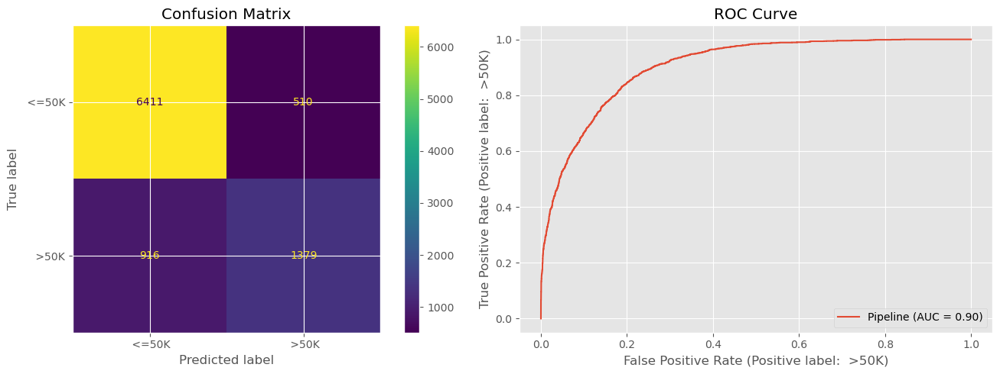

08-May-23 00:01:54 - Model Model 1 trained successfully!


In [8]:
# Create empty models
initial_models, msg = fill_empty_models(df_X, df_y, 4)
models = []

model1 = initial_models[0]
msg = fill_model(model1, Algorithm.LOGISTIC_REGRESSION, Split(SplitTypes.NORMAL))
models.append(model1)
model_1 = models[0]

 * Model 2: Decision Tree

Fitting 5 folds for each of 160 candidates, totalling 800 fits


08-May-23 00:02:19 - Model accuracy: 0.8488498263888888


tuned hpyerparameters :(best parameters)  {'model__criterion': 'gini', 'model__max_depth': 8, 'model__max_features': 1.0, 'model__splitter': 'best'}
accuracy : 0.8522924468620061


08-May-23 00:02:20 - Classification report: 
              precision    recall  f1-score   support

       <=50K       0.87      0.94      0.90      6921
        >50K       0.77      0.57      0.65      2295

    accuracy                           0.85      9216
   macro avg       0.82      0.75      0.78      9216
weighted avg       0.84      0.85      0.84      9216



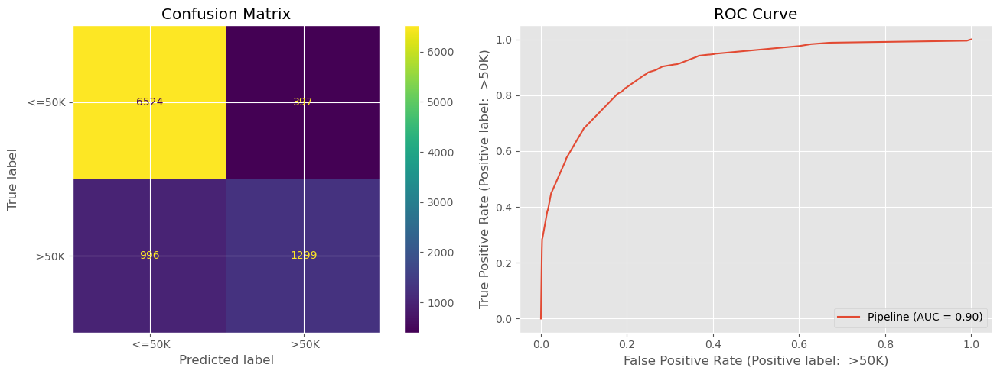

08-May-23 00:02:20 - Model Model 2 trained successfully!


In [9]:
model2 = initial_models[1]
msg = fill_model(model2, Algorithm.DECISION_TREE, Split(SplitTypes.NORMAL))
models.append(model2)
model_2 = models[1]

 * Model 3: Random Forest

Fitting 5 folds for each of 50 candidates, totalling 250 fits
tuned hpyerparameters :(best parameters)  {'model__n_estimators': 4500, 'model__min_samples_split': 5, 'model__min_samples_leaf': 4, 'model__max_features': 'sqrt', 'model__max_depth': 57, 'model__criterion': 'gini', 'model__bootstrap': False}
accuracy : 0.8615475362679312


08-May-23 04:18:27 - Model accuracy: 0.8598090277777778
08-May-23 04:18:27 - Classification report: 
              precision    recall  f1-score   support

       <=50K       0.89      0.93      0.91      6921
        >50K       0.76      0.64      0.69      2295

    accuracy                           0.86      9216
   macro avg       0.82      0.78      0.80      9216
weighted avg       0.85      0.86      0.86      9216



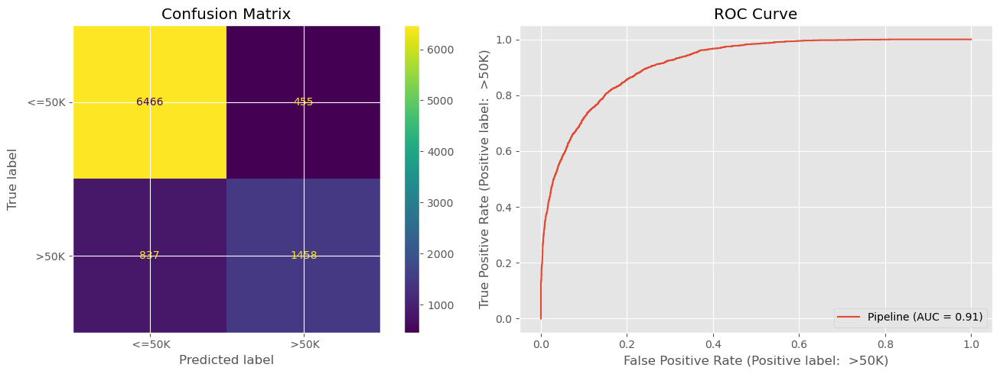

08-May-23 04:18:36 - Model Model 3 trained successfully!


In [10]:
model3 = initial_models[2]
msg = fill_model(model3, Algorithm.RANDOM_FOREST, Split(SplitTypes.NORMAL))
models.append(model3)
model_3 = models[2]

 * Model 4: Support Vector Machine

Fitting 5 folds for each of 50 candidates, totalling 250 fits
tuned hpyerparameters :(best parameters)  {'model__gamma': 0.1, 'model__C': 10.0}
accuracy : 0.8501999426850435


08-May-23 20:10:56 - Model accuracy: 0.8490668402777778
08-May-23 20:10:56 - Classification report: 
              precision    recall  f1-score   support

       <=50K       0.88      0.92      0.90      6921
        >50K       0.73      0.63      0.67      2295

    accuracy                           0.85      9216
   macro avg       0.81      0.78      0.79      9216
weighted avg       0.84      0.85      0.85      9216



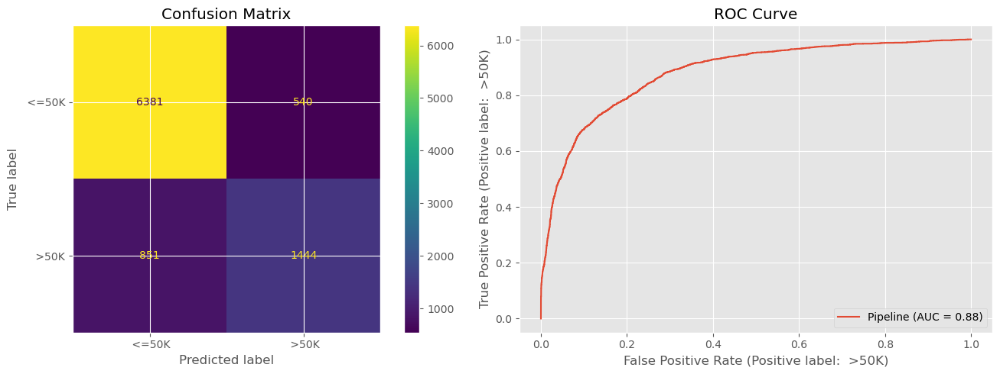

08-May-23 20:11:05 - Model Model 4 trained successfully!


In [11]:
model4 = initial_models[3]
msg = fill_model(model4, Algorithm.SVC, Split(SplitTypes.NORMAL))
models.append(model4)
model_4 = models[3]

## Global model interpretations
In the following steps we will use global interpretation techniques that help us to answer questions like how does a model behave in general? What features drive predictions and what features are completely useless. This data may be very important in understanding the model better. Most of the techniques work by investigating the conditional interactions between the target variable and the features on the complete dataset.

### Feature importance
The importance of a feature is the increase in the prediction error of the model after we permuted the feature’s values, which breaks the relationship between the feature and the true outcome. A feature is “important” if permuting it increases the model error. This is because in that case, the model relied heavily on this feature for making right prediction. On the other hand, a feature is “unimportant” if permuting it doesn’t affect the error by much or doesn’t change it at all.

#### ELI5
In the first case, we use [ELI5](https://github.com/TeamHG-Memex/eli5), which does not permute the features but only visualizes the weight of each feature.

 * Model 1 (Logistic Regression)

In [12]:
plot = generate_feature_importance_plot(FeatureImportanceType.ELI5, model_1)
display(plot)

08-May-23 20:11:05 - Generating a feature importance plot using ELI5 for Model 1 ...


Weight?,Feature
+2.318,capital-gain
+1.413,marital-status_ Married-AF-spouse
+1.383,marital-status_ Married-civ-spouse
+1.350,relationship_ Wife
+0.894,occupation_ Exec-managerial
+0.875,gender_ Male
+0.798,education-num
+0.746,occupation_ Tech-support
+0.683,occupation_ Prof-specialty
+0.642,workclass_ Federal-gov


 * Model 2 (Decision Tree)

In [13]:
plot = generate_feature_importance_plot(FeatureImportanceType.ELI5, model_2)
display(plot)

08-May-23 20:11:05 - Generating a feature importance plot using ELI5 for Model 2 ...


Weight,Feature
0.4069,marital-status_ Married-civ-spouse
0.2173,education-num
0.1976,capital-gain
0.0633,capital-loss
0.0463,age
0.0335,hours-per-week
0.0067,occupation_ Exec-managerial
0.0046,relationship_ Wife
0.0044,education_ Bachelors
0.0037,education_ Masters


 * Model 3 (Random Forest)

In [14]:
plot = generate_feature_importance_plot(FeatureImportanceType.ELI5, model_3)
display(plot)

08-May-23 20:11:05 - Generating a feature importance plot using ELI5 for Model 3 ...


Weight,Feature
0.1615 ± 0.1095,capital-gain
0.1340 ± 0.2561,marital-status_ Married-civ-spouse
0.1110 ± 0.1314,education-num
0.0887 ± 0.0889,age
0.0827 ± 0.2099,relationship_ Husband
0.0566 ± 0.0597,hours-per-week
0.0442 ± 0.1302,marital-status_ Never-married
0.0371 ± 0.0346,capital-loss
0.0291 ± 0.0453,occupation_ Exec-managerial
0.0228 ± 0.0422,occupation_ Prof-specialty


 * Model 4 (Support Vector Machine)

In [15]:
%%script false --no-raise-error
plot = generate_feature_importance_plot(FeatureImportanceType.ELI5, model_4)
display(plot)

Couldn't find program: 'false'


In [75]:
rbos_eli5=calculate_feature_importance_rbo(FeatureImportanceType.ELI5, models, 5, 20, 1)
display(rbos_eli5.style
        .background_gradient(
            subset=['Model 1_Model 2', 'Model 1_Model 3', 'Model 2_Model 3'],
            vmin=0.5, vmax=0.99, cmap=cm.get_cmap('Blues') )
        .hide_index()
        .background_gradient(
            subset=['Mean'],
            cmap=cm.get_cmap('Reds')))

p,d,Model 1_Model 2,Model 1_Model 3,Model 2_Model 3,Mean
0.800000,5,0.300000,0.580000,0.612000,0.497000
0.833000,6,0.291000,0.528000,0.656000,0.492000
0.857000,7,0.394000,0.542000,0.634000,0.523000
0.875000,8,0.434000,0.507000,0.660000,0.534000
0.889000,9,0.424000,0.521000,0.681000,0.542000
0.900000,10,0.414000,0.535000,0.661000,0.537000
0.909000,11,0.439000,0.513000,0.676000,0.543000
0.917000,12,0.462000,0.493000,0.690000,0.548000
0.923000,13,0.482000,0.505000,0.702000,0.563000
0.929000,14,0.474000,0.516000,0.713000,0.568000


In [76]:
display(rbos_eli5[rbos_eli5['Mean'] == rbos_eli5['Mean'].max()])

,p,d,Model 1_Model 2,Model 1_Model 3,Model 2_Model 3,Mean
12,0.941,17,0.518,0.523,0.74,0.594


#### Skater

In this step we use the [Skater](https://github.com/oracle/Skater) module, which permutes the features to generate a feature importance plot.

 * Model 1 (Logistic Regression)

08-May-23 20:11:07 - Generating a feature importance plot using SKATER for Model 1 ...
08-May-23 20:11:07 - Initializing Skater - generating new in-memory model. This operation may be time-consuming so please be patient.
2023-05-08 20:11:08,755 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[61/61] features ████████████████████ Time elapsed: 3 seconds

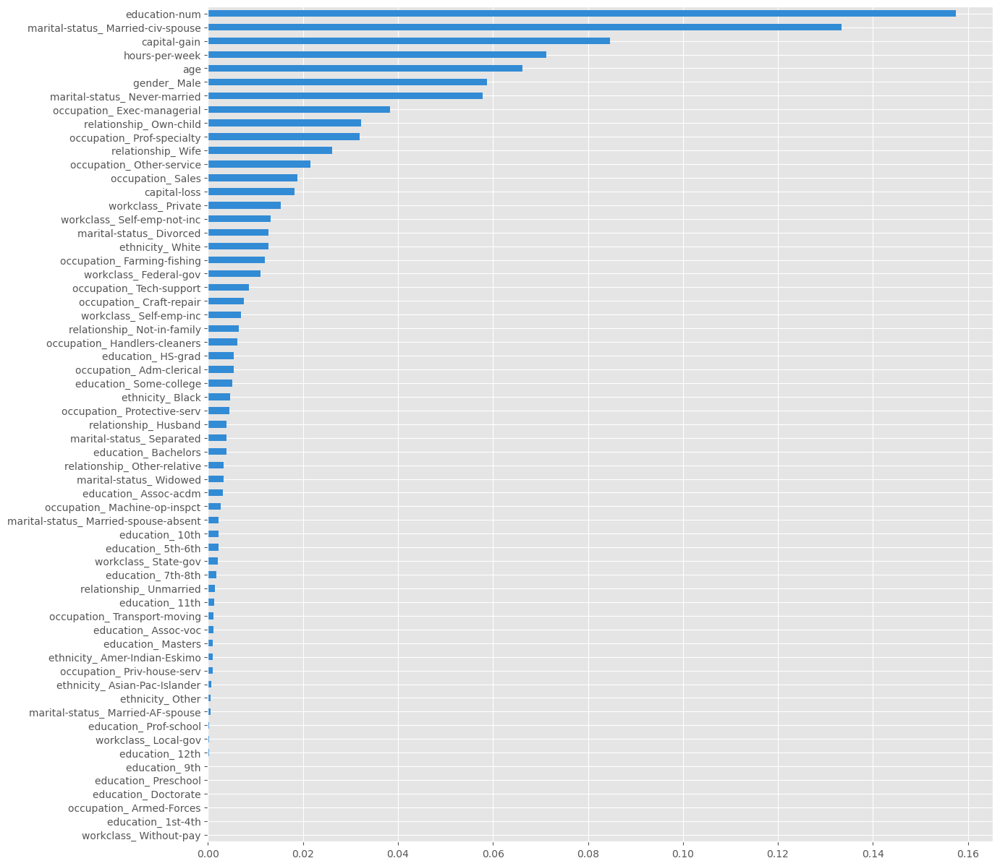

In [18]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [14, 15]
plt.style.use('ggplot')
warnings.filterwarnings('ignore')

plot = generate_feature_importance_plot(FeatureImportanceType.SKATER, model_1)
display(plot)

 * Model 2 (Decision Tree)

08-May-23 20:11:12 - Generating a feature importance plot using SKATER for Model 2 ...
08-May-23 20:11:12 - Initializing Skater - generating new in-memory model. This operation may be time-consuming so please be patient.
2023-05-08 20:11:14,030 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[61/61] features ████████████████████ Time elapsed: 3 seconds

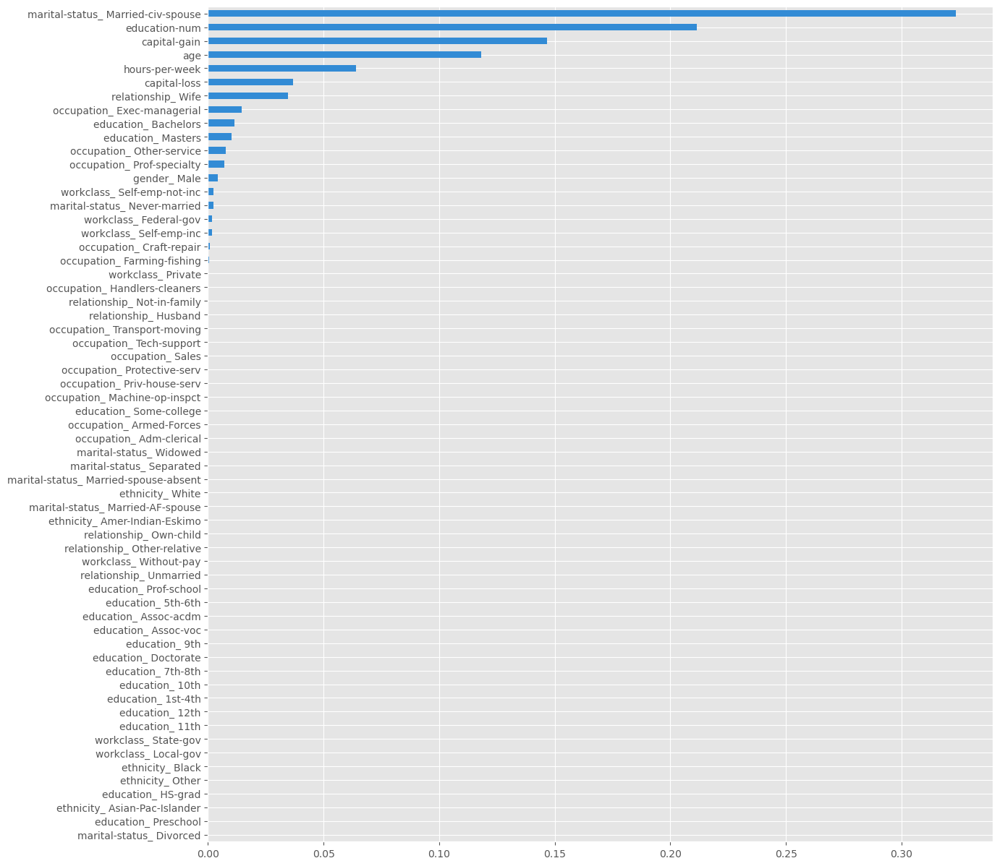

In [19]:
plot = generate_feature_importance_plot(FeatureImportanceType.SKATER, model_2)
display(plot)

 * Model 3 (Random Forest)

08-May-23 20:11:17 - Generating a feature importance plot using SKATER for Model 3 ...
08-May-23 20:11:17 - Initializing Skater - generating new in-memory model. This operation may be time-consuming so please be patient.
2023-05-08 20:11:25,252 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[61/61] features ████████████████████ Time elapsed: 182 seconds

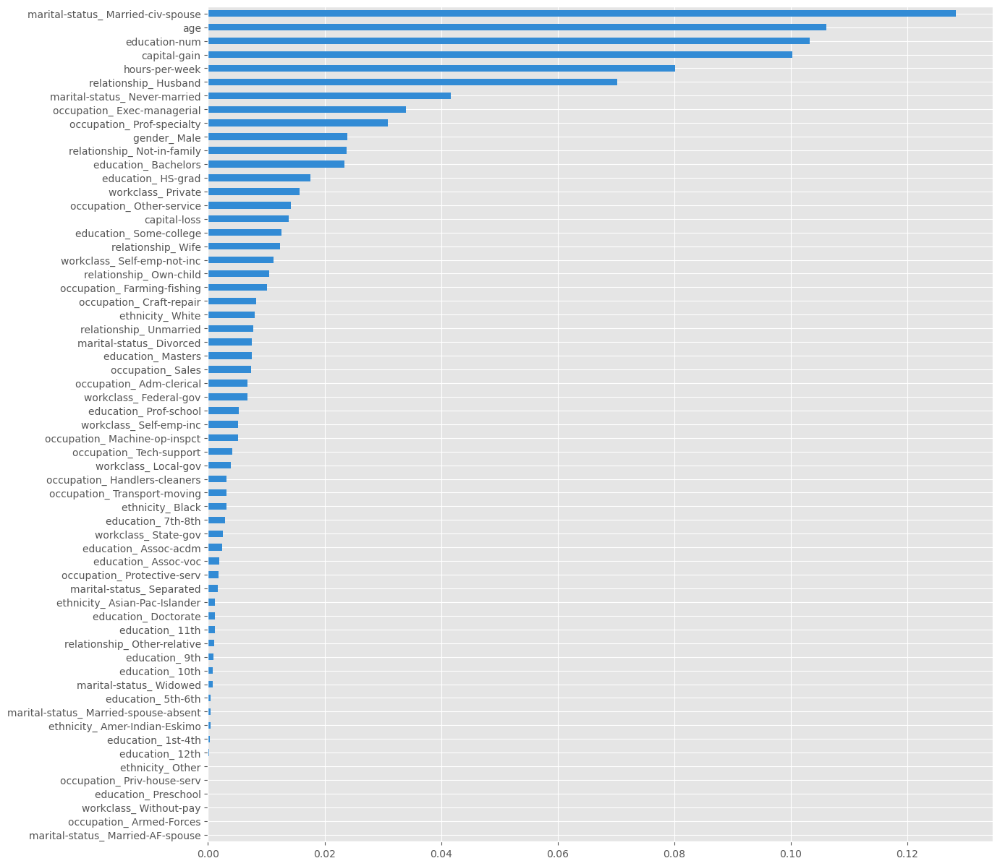

In [20]:
plot = generate_feature_importance_plot(FeatureImportanceType.SKATER, model_3)
display(plot)

 * Model 4 (Support Vector Machine)

08-May-23 20:14:28 - Generating a feature importance plot using SKATER for Model 4 ...
08-May-23 20:14:28 - Initializing Skater - generating new in-memory model. This operation may be time-consuming so please be patient.
2023-05-08 20:14:36,556 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[61/61] features ████████████████████ Time elapsed: 11 seconds

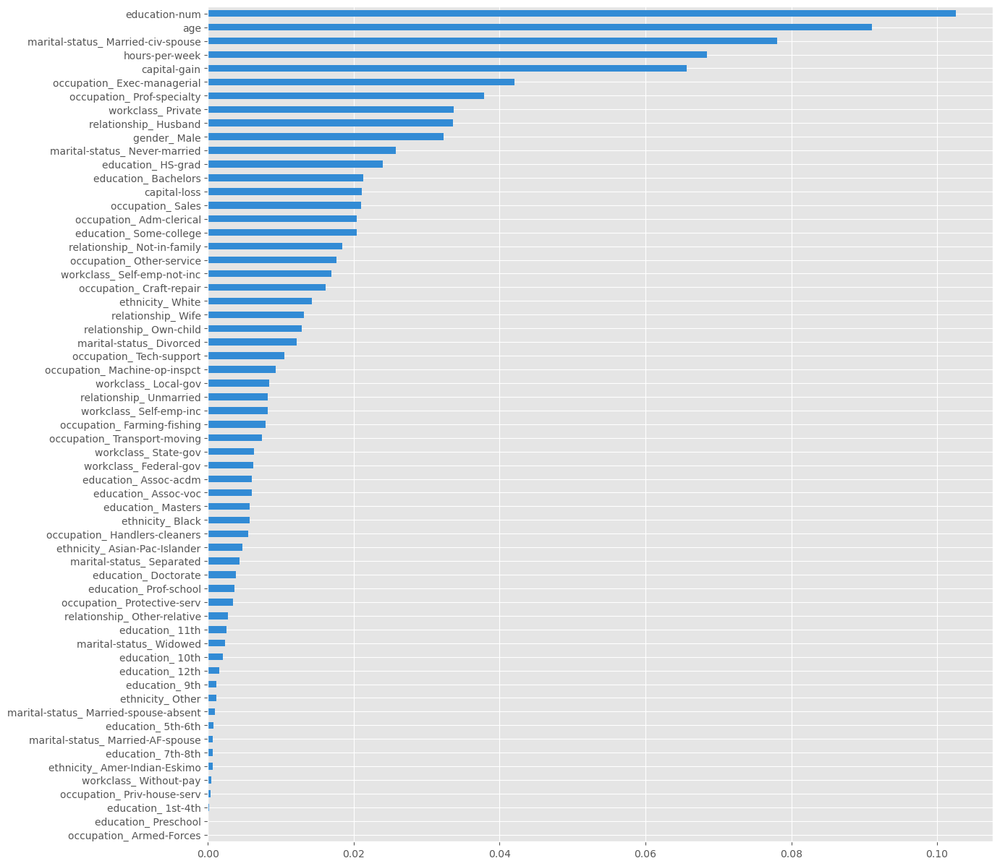

In [21]:
plot = generate_feature_importance_plot(FeatureImportanceType.SKATER, model_4)
display(plot)

In [77]:
rbos_skater=calculate_feature_importance_rbo(FeatureImportanceType.SKATER, models, 5, 20, 1)
display(rbos_skater.style
        .background_gradient(
            subset=['Model 1_Model 2', 'Model 1_Model 3', 'Model 1_Model 4', 'Model 2_Model 3', 'Model 2_Model 4', 'Model 3_Model 4'],
            vmin=0.5, vmax=0.99, cmap=cm.get_cmap('Blues') )
        .hide_index()
        .background_gradient(
            subset=['Mean'],
            cmap=cm.get_cmap('Reds')))

p,d,Model 1_Model 2,Model 1_Model 3,Model 1_Model 4,Model 2_Model 3,Model 2_Model 4,Model 3_Model 4,Mean
0.800000,5,0.774000,0.652000,0.852000,0.877000,0.652000,0.694000,0.750000
0.833000,6,0.742000,0.634000,0.801000,0.825000,0.634000,0.672000,0.718000
0.857000,7,0.710000,0.671000,0.757000,0.780000,0.614000,0.649000,0.697000
0.875000,8,0.729000,0.700000,0.768000,0.789000,0.643000,0.674000,0.717000
0.889000,9,0.701000,0.680000,0.734000,0.753000,0.623000,0.739000,0.705000
0.900000,10,0.675000,0.738000,0.781000,0.722000,0.603000,0.756000,0.712000
0.909000,11,0.687000,0.720000,0.789000,0.693000,0.585000,0.771000,0.708000
0.917000,12,0.728000,0.702000,0.764000,0.731000,0.600000,0.753000,0.713000
0.923000,13,0.737000,0.685000,0.741000,0.737000,0.642000,0.793000,0.722000
0.929000,14,0.746000,0.669000,0.747000,0.715000,0.654000,0.804000,0.722000


In [78]:
display(rbos_skater[rbos_skater['Mean'] == rbos_skater['Mean'].max()])

,p,d,Model 1_Model 2,Model 1_Model 3,Model 1_Model 4,Model 2_Model 3,Model 2_Model 4,Model 3_Model 4,Mean
0,0.8,5,0.774,0.652,0.852,0.877,0.652,0.694,0.75


#### Shap

In the cell below we use the [SHAP](https://github.com/slundberg/shap) (SHapley Additive exPlanations). It uses a combination of feature contributions and game theory to come up with SHAP values. Then, it computes the global feature importance by taking the average of the SHAP value magnitudes across the dataset.

 * Model 1 (Logistic Regression)

08-May-23 20:14:49 - Generating a feature importance plot using SHAP for Model 1 ...
08-May-23 20:14:49 - Initializing Shap - calculating shap values. This operation is time-consuming so please be patient.


  0%|          | 0/9216 [00:00<?, ?it/s]

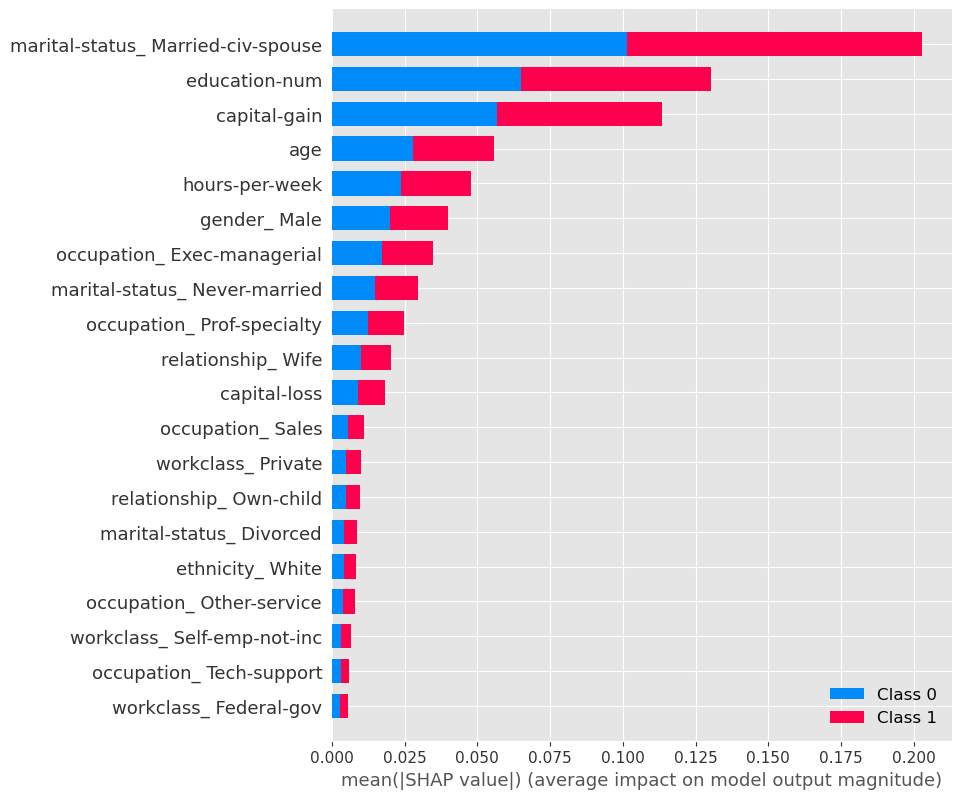

In [24]:
from shap import initjs
initjs()

%matplotlib inline
plt.style.use('ggplot')
warnings.filterwarnings('ignore')

generate_feature_importance_plot(FeatureImportanceType.SHAP, model_1)

 * Model 2 (Decision Tree)

08-May-23 20:16:12 - Generating a feature importance plot using SHAP for Model 2 ...
08-May-23 20:16:12 - Initializing Shap - calculating shap values. This operation is time-consuming so please be patient.


  0%|          | 0/9216 [00:00<?, ?it/s]

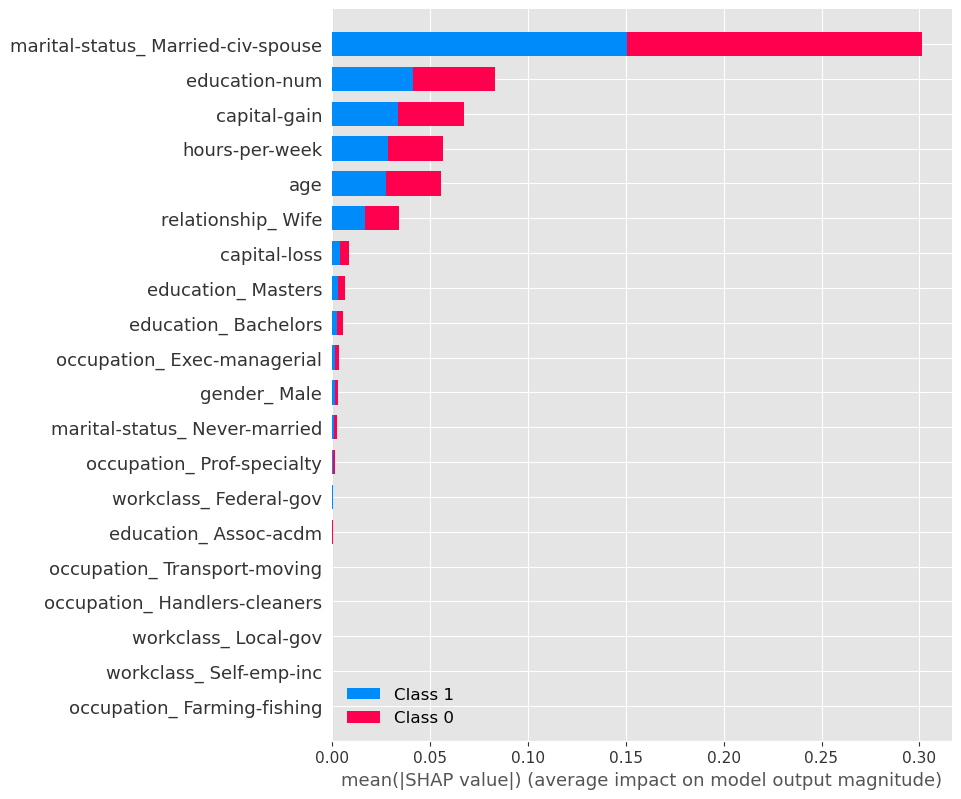

In [25]:
generate_feature_importance_plot(FeatureImportanceType.SHAP, model_2)

 * Model 3 (Random Forest)

08-May-23 20:17:32 - Generating a feature importance plot using SHAP for Model 3 ...
08-May-23 20:17:32 - Initializing Shap - calculating shap values. This operation is time-consuming so please be patient.


  0%|          | 0/9216 [00:00<?, ?it/s]

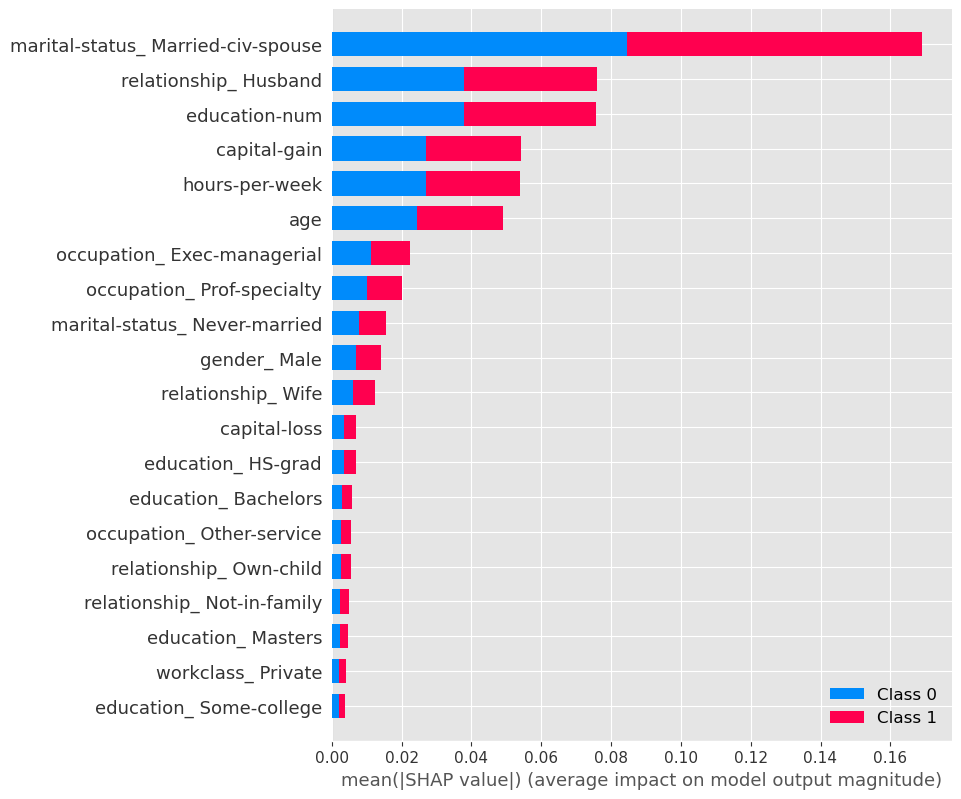

In [26]:
generate_feature_importance_plot(FeatureImportanceType.SHAP, model_3)

 * Model 4 (Support Vector Machine)

08-May-23 22:38:52 - Generating a feature importance plot using SHAP for Model 4 ...
08-May-23 22:38:52 - Initializing Shap - calculating shap values. This operation is time-consuming so please be patient.


  0%|          | 0/9216 [00:00<?, ?it/s]

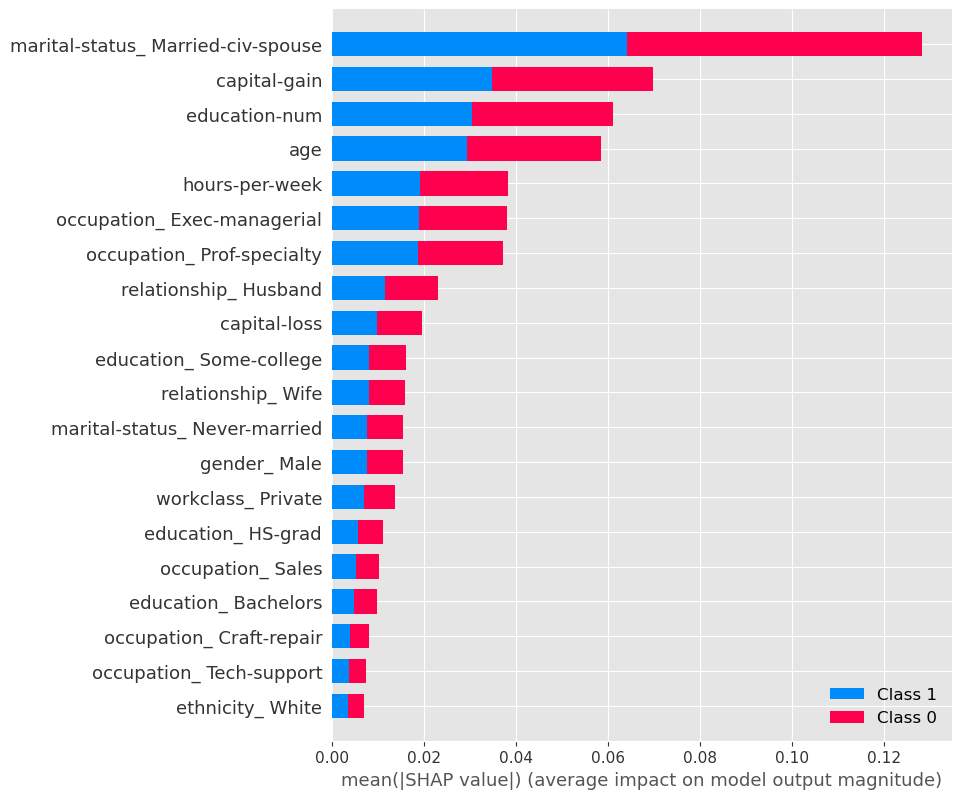

In [27]:
generate_feature_importance_plot(FeatureImportanceType.SHAP, model_4)

In [79]:
rbos_shap=calculate_feature_importance_rbo(FeatureImportanceType.SHAP, models, 5, 20, 1)
display(rbos_shap.style
        .background_gradient(
            subset=['Model 1_Model 2', 'Model 1_Model 3', 'Model 1_Model 4', 'Model 2_Model 3', 'Model 2_Model 4', 'Model 3_Model 4'],
            vmin=0.5, vmax=0.99, cmap=cm.get_cmap('Blues') )
        .hide_index()
        .background_gradient(
            subset=['Mean'],
            cmap=cm.get_cmap('Reds')))

p,d,Model 1_Model 2,Model 1_Model 3,Model 1_Model 4,Model 2_Model 3,Model 2_Model 4,Model 3_Model 4,Mean
0.800000,5,0.974000,0.770000,0.920000,0.770000,0.894000,0.770000,0.850000
0.833000,6,0.909000,0.785000,0.864000,0.785000,0.839000,0.785000,0.828000
0.857000,7,0.853000,0.798000,0.871000,0.742000,0.792000,0.798000,0.809000
0.875000,8,0.805000,0.761000,0.828000,0.704000,0.750000,0.859000,0.784000
0.889000,9,0.763000,0.814000,0.834000,0.670000,0.757000,0.827000,0.778000
0.900000,10,0.803000,0.824000,0.800000,0.680000,0.763000,0.797000,0.778000
0.909000,11,0.841000,0.832000,0.839000,0.723000,0.769000,0.805000,0.801000
0.917000,12,0.843000,0.840000,0.843000,0.763000,0.775000,0.844000,0.818000
0.923000,13,0.847000,0.817000,0.847000,0.771000,0.810000,0.851000,0.824000
0.929000,14,0.822000,0.796000,0.851000,0.779000,0.788000,0.829000,0.811000


In [80]:
display(rbos_shap[rbos_shap['Mean'] == rbos_shap['Mean'].max()])

,p,d,Model 1_Model 2,Model 1_Model 3,Model 1_Model 4,Model 2_Model 3,Model 2_Model 4,Model 3_Model 4,Mean
0,0.8,5,0.974,0.77,0.92,0.77,0.894,0.77,0.85


#### Rank-biased Overlap (RBO)
Rank-Biased Overlap (RBO) is a similarity metric used to compare the similarity of two ranked lists based on the degree of overlap between their items. The RBO score ranges from 0 to 1, where 1 represents complete overlap between the two lists, and 0 indicates no overlap. With the RBO method we will compare the different feature importance lists for the same model.
 * Model 1 (Logistic Regression)

In [81]:
rbos_model_1 = calculate_model_rbo(model_1, 5, 25, 1)
display(rbos_model_1.style
        .background_gradient(
            subset=['ELI5_SKATER', 'ELI5_SHAP', 'SKATER_SHAP'],
            vmin=0.5, vmax=0.99, cmap=cm.get_cmap('Blues') )
        .hide_index()
        .background_gradient(
            subset=['Mean'],
            cmap=cm.get_cmap('Reds')))

p,d,ELI5_SKATER,ELI5_SHAP,SKATER_SHAP,Mean
0.800000,5,0.300000,0.300000,0.774000,0.458000
0.833000,6,0.358000,0.358000,0.809000,0.508000
0.857000,7,0.405000,0.462000,0.778000,0.548000
0.875000,8,0.445000,0.453000,0.846000,0.581000
0.889000,9,0.435000,0.486000,0.818000,0.580000
0.900000,10,0.463000,0.514000,0.831000,0.603000
0.909000,11,0.488000,0.504000,0.841000,0.611000
0.917000,12,0.478000,0.494000,0.818000,0.597000
0.923000,13,0.468000,0.483000,0.826000,0.592000
0.929000,14,0.487000,0.501000,0.860000,0.616000


In [82]:
display(rbos_model_1[rbos_model_1['Mean'] == rbos_model_1['Mean'].max()])

,p,d,ELI5_SKATER,ELI5_SHAP,SKATER_SHAP,Mean
18,0.957,23,0.574,0.591,0.915,0.693
19,0.958,24,0.581,0.598,0.901,0.693


 * Model 2 (Decision Tree)

In [31]:
rbos_model_2 = calculate_model_rbo(model_2, 5, None, 1)
display(rbos_model_2.style
        .background_gradient(
            subset=['ELI5_SKATER', 'ELI5_SHAP', 'SKATER_SHAP'],
            vmin=0.5, vmax=0.99, cmap=cm.get_cmap('Blues') )
        .hide_index()
        .background_gradient(
            subset=['Mean'],
            cmap=cm.get_cmap('Reds')))

p,d,ELI5_SKATER,ELI5_SHAP,SKATER_SHAP,Mean
0.800000,5,0.892000,0.892000,0.974000,0.919000
0.833000,6,0.960000,0.893000,0.909000,0.921000
0.857000,7,0.905000,0.894000,0.966000,0.922000
0.875000,8,0.956000,0.897000,0.919000,0.924000
0.889000,9,0.959000,0.899000,0.921000,0.926000
0.900000,10,0.961000,0.940000,0.961000,0.954000
0.909000,11,0.928000,0.943000,0.928000,0.933000
0.917000,12,0.930000,0.914000,0.897000,0.914000
0.923000,13,0.932000,0.916000,0.928000,0.925000
0.929000,14,0.933000,0.918000,0.902000,0.918000


In [83]:
display(rbos_model_2[rbos_model_2['Mean'] == rbos_model_2['Mean'].max()])

,p,d,ELI5_SKATER,ELI5_SHAP,SKATER_SHAP,Mean
5,0.9,10,0.961,0.94,0.961,0.954


 * Model 3 (Random Forest)

In [84]:
rbos_model_3 = calculate_model_rbo(model_3, 5, 25, 1)
display(rbos_model_3.style
        .background_gradient(
            subset=['ELI5_SKATER', 'ELI5_SHAP', 'SKATER_SHAP'],
            vmin=0.5, vmax=0.99, cmap=cm.get_cmap('Blues') )
        .hide_index()
        .background_gradient(
            subset=['Mean'],
            cmap=cm.get_cmap('Reds')))

p,d,ELI5_SKATER,ELI5_SHAP,SKATER_SHAP,Mean
0.800000,5,0.595000,0.570000,0.770000,0.645000
0.833000,6,0.709000,0.685000,0.852000,0.749000
0.857000,7,0.745000,0.666000,0.809000,0.740000
0.875000,8,0.725000,0.647000,0.821000,0.731000
0.889000,9,0.747000,0.714000,0.874000,0.778000
0.900000,10,0.765000,0.734000,0.883000,0.794000
0.909000,11,0.746000,0.715000,0.856000,0.772000
0.917000,12,0.791000,0.731000,0.831000,0.784000
0.923000,13,0.802000,0.743000,0.837000,0.794000
0.929000,14,0.786000,0.782000,0.842000,0.803000


In [85]:
display(rbos_model_3[rbos_model_3['Mean'] == rbos_model_3['Mean'].max()])

,p,d,ELI5_SKATER,ELI5_SHAP,SKATER_SHAP,Mean
13,0.944,18,0.811,0.834,0.859,0.835


 * Model 4 (Support Vector Machine)

In [33]:
rbos_model_4 = calculate_model_rbo(model_4, 5, None, 1)
display(rbos_model_4.style
        .background_gradient(
            subset=['SKATER_SHAP'],
            vmin=0.5, vmax=0.99, cmap=cm.get_cmap('Blues') )
        .hide_index()
        .background_gradient(
            subset=['Mean'],
            cmap=cm.get_cmap('Reds')))

p,d,SKATER_SHAP,Mean
0.800000,5,0.572000,0.572000
0.833000,6,0.631000,0.631000
0.857000,7,0.677000,0.677000
0.875000,8,0.664000,0.664000
0.889000,9,0.692000,0.692000
0.900000,10,0.677000,0.677000
0.909000,11,0.661000,0.661000
0.917000,12,0.678000,0.678000
0.923000,13,0.692000,0.692000
0.929000,14,0.733000,0.733000


In [ ]:
display(rbos_model_4[rbos_model_4['Mean'] == rbos_model_4['Mean'].max()])

### Partial Dependence Plots
The partial dependence plot (short PDP or PD plot) shows the marginal effect one or two features have on the predicted outcome of a machine learning model. A partial dependence plot can show whether the relationship between the target and a feature is linear, monotonic or more complex. For example, when applied to a linear regression model, partial dependence plots always show a linear relationship.

#### PDPBox

[PDPBox](https://github.com/SauceCat/PDPbox) is the first module that we use for ploting partial dependence. We will generate two plots, one for only one feature - **age** and one for two features - **age** and **education-num**.
 * Model 1 (Logistic Regression)

08-May-23 23:12:21 - Generating a PDP plot using PDPBox for Model 1 ...


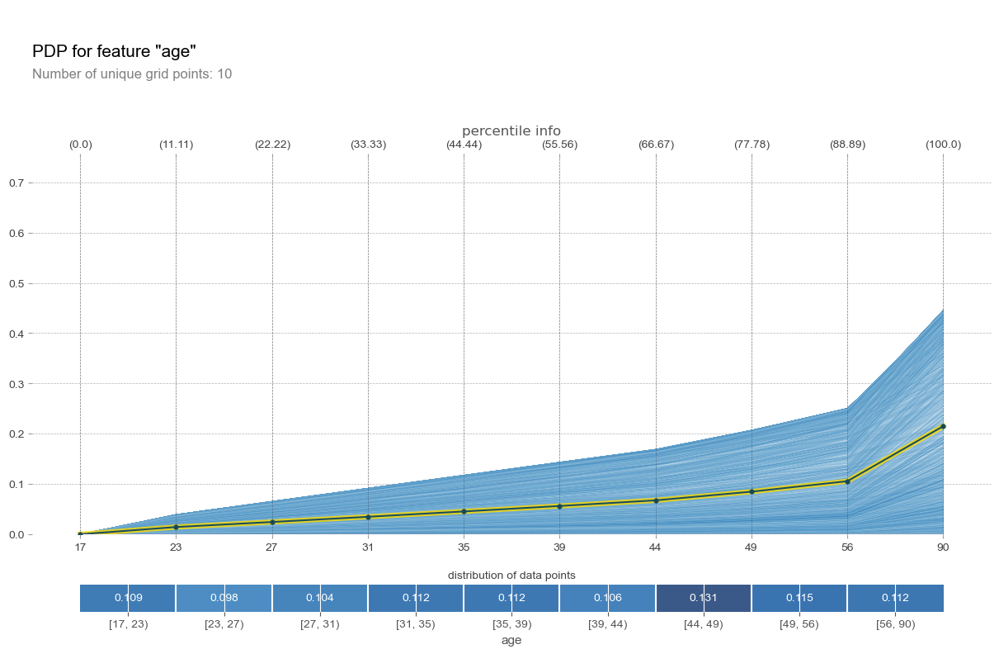

In [34]:
_ = generate_pdp_plots(PDPType.PDPBox, model_1, "age", "None")

08-May-23 23:12:26 - Generating a PDP plot using PDPBox for Model 1 ...


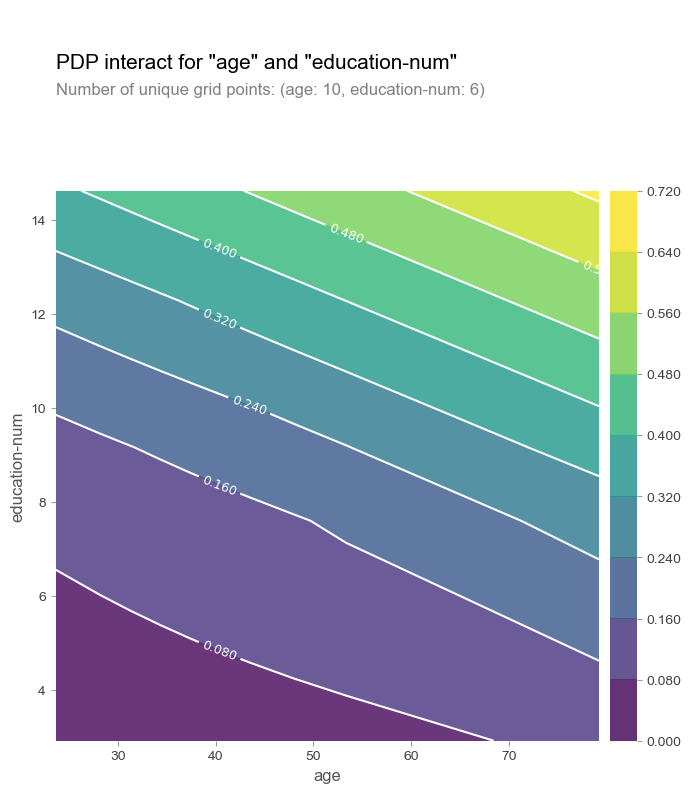

In [35]:
_ = generate_pdp_plots(PDPType.PDPBox, model_1, "age", "education-num")

 * Model 2 (Decision Tree)

08-May-23 23:12:27 - Generating a PDP plot using PDPBox for Model 2 ...


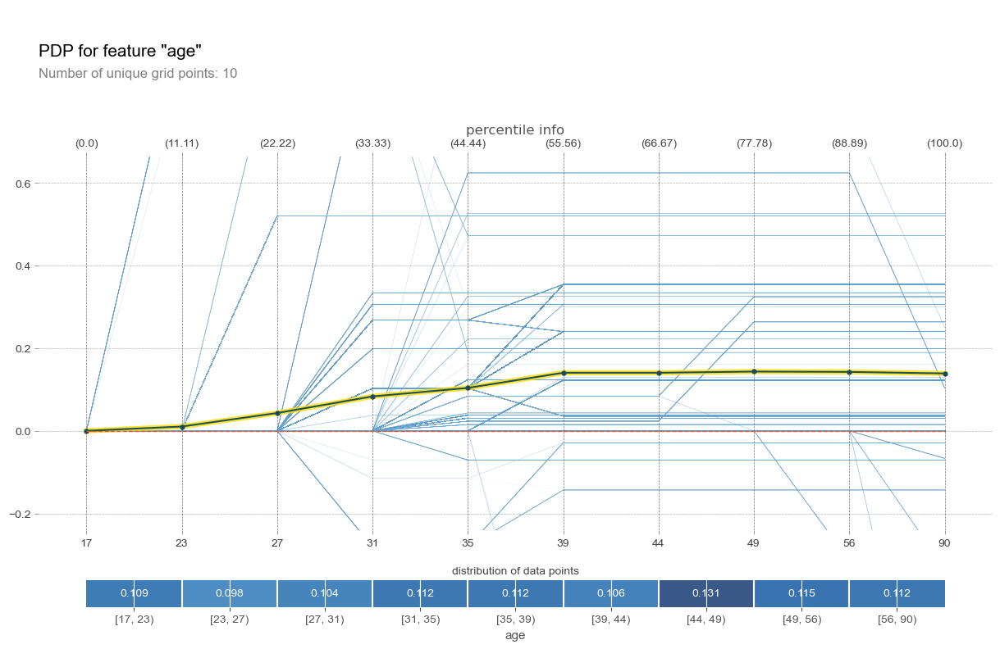

In [36]:
_ = generate_pdp_plots(PDPType.PDPBox, model_2, "age", "None")

08-May-23 23:12:32 - Generating a PDP plot using PDPBox for Model 2 ...


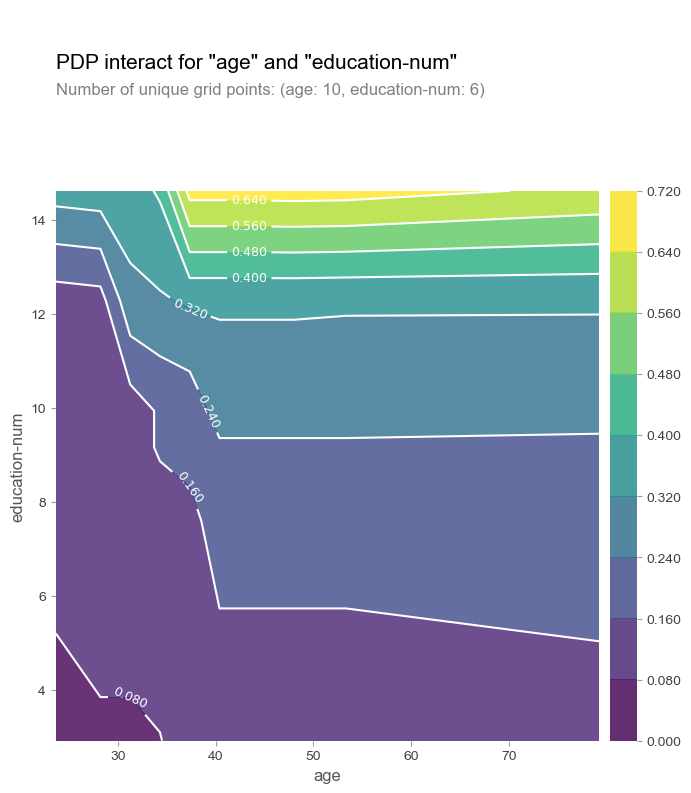

In [37]:
_ = generate_pdp_plots(PDPType.PDPBox, model_2, "age", "education-num")

 * Model 3 (Random Forest)

08-May-23 23:12:32 - Generating a PDP plot using PDPBox for Model 3 ...


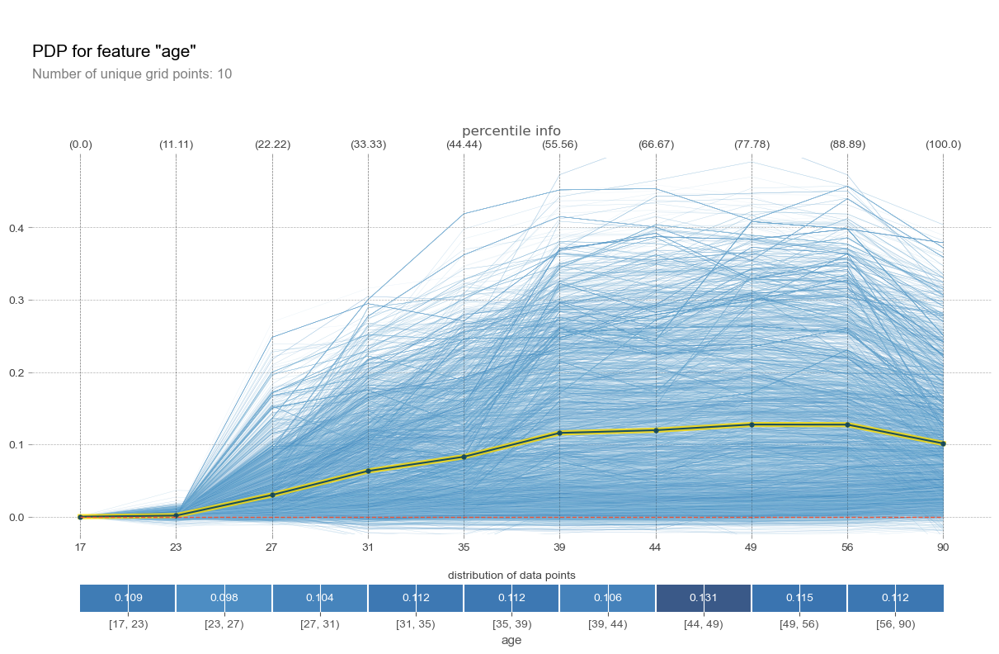

In [38]:
_ = generate_pdp_plots(PDPType.PDPBox, model_3, "age", "None")

08-May-23 23:13:05 - Generating a PDP plot using PDPBox for Model 3 ...


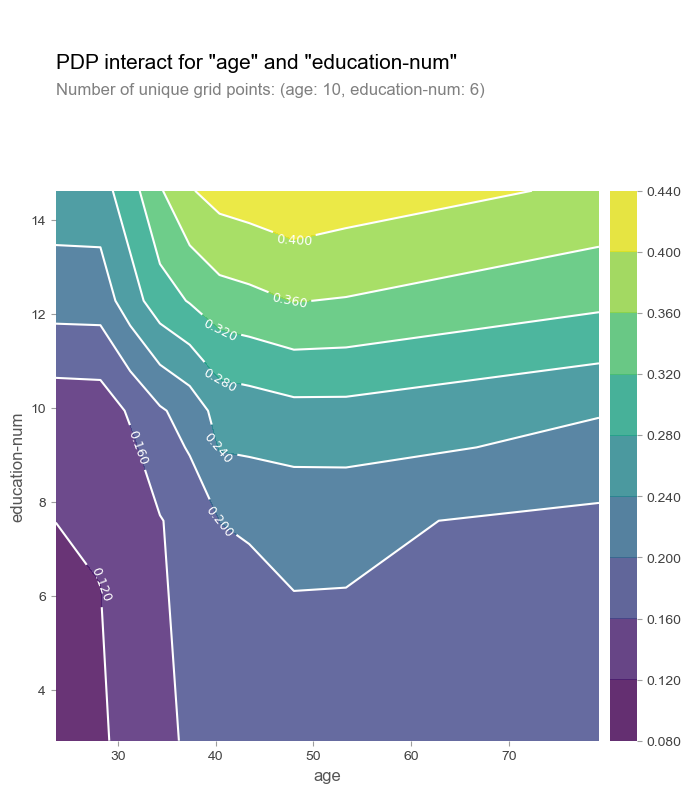

In [39]:
_ = generate_pdp_plots(PDPType.PDPBox, model_3, "age", "education-num")

 * Model 4 (Support Vector Machine)

08-May-23 23:16:38 - Generating a PDP plot using PDPBox for Model 4 ...


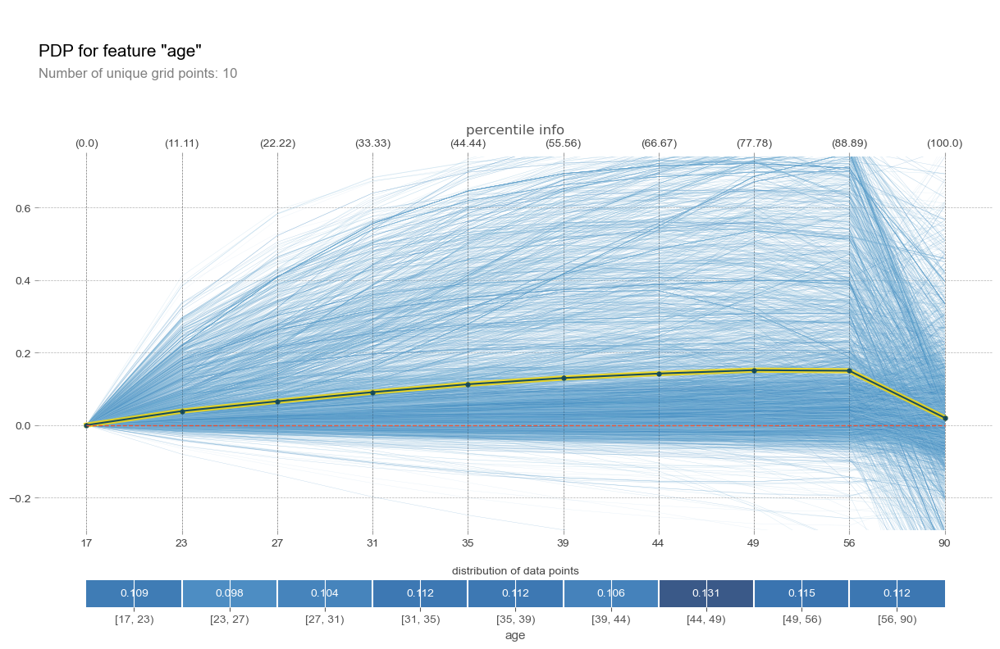

In [40]:
_ = generate_pdp_plots(PDPType.PDPBox, model_4, "age", "None")

08-May-23 23:17:14 - Generating a PDP plot using PDPBox for Model 4 ...


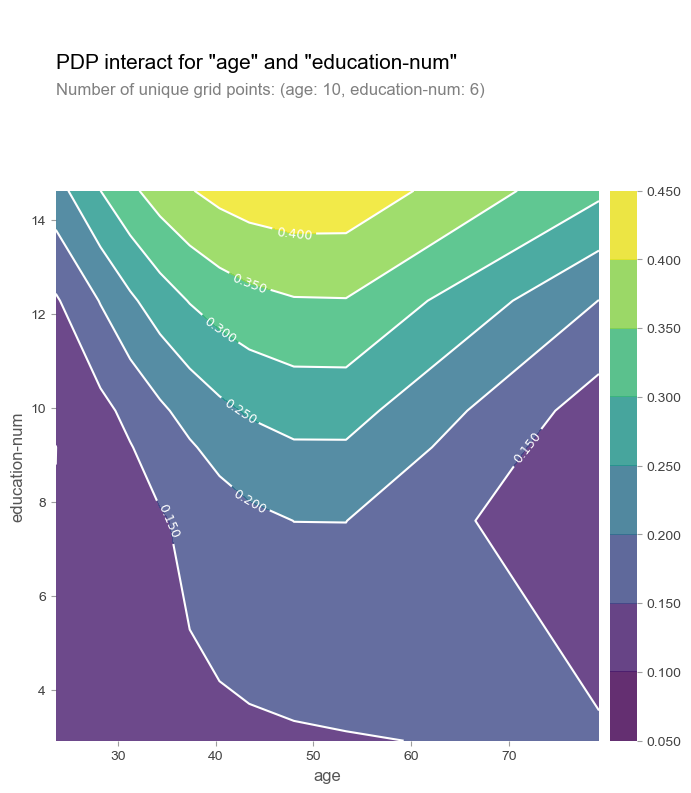

In [41]:
_ = generate_pdp_plots(PDPType.PDPBox, model_4, "age", "education-num")

In the two examples below we will use *Skater* and *SHAP* for generating PDPs using features: **age** and **education-num**.
#### Skater
 * Model 1 (Logistic Regression)

08-May-23 23:21:05 - Generating a PDP plot using SKATER for Model 1 ...
2023-05-08 23:21:06,020 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progressbar=False


[1136/1136] grid cells ████████████████████ Time elapsed: 28 seconds

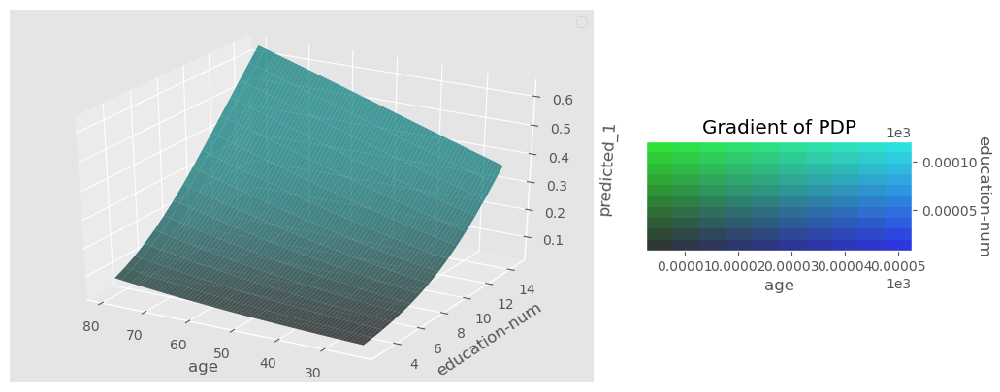

In [42]:
%matplotlib inline
plt.style.use('ggplot')
warnings.filterwarnings('ignore')
_ = generate_pdp_plots(PDPType.SKATER, model_1, "age", "education-num")

 * Model 2 (Decision Tree)

08-May-23 23:21:35 - Generating a PDP plot using SKATER for Model 2 ...
2023-05-08 23:21:36,334 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progressbar=False


[1136/1136] grid cells ████████████████████ Time elapsed: 30 seconds

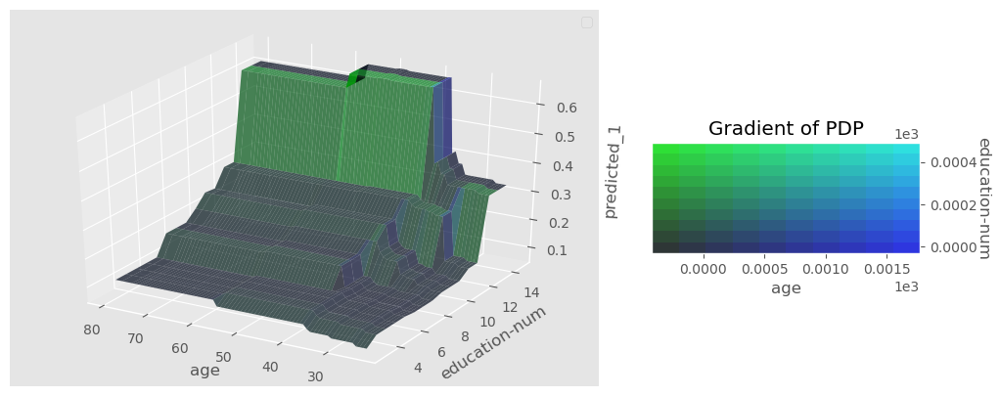

In [43]:
_ = generate_pdp_plots(PDPType.SKATER, model_2, "age", "education-num")

 * Model 3 (Random Forest)

08-May-23 23:22:07 - Generating a PDP plot using SKATER for Model 3 ...
2023-05-08 23:22:08,520 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progressbar=False


[1136/1136] grid cells ████████████████████ Time elapsed: 3401 seconds

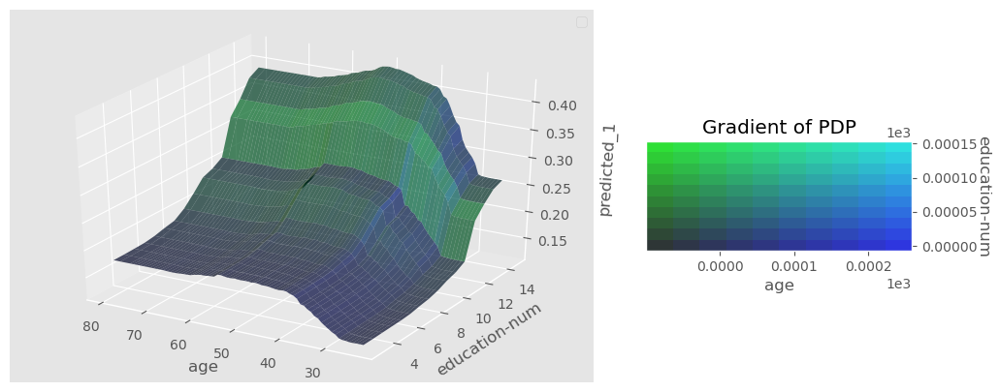

In [44]:
_ = generate_pdp_plots(PDPType.SKATER, model_3, "age", "education-num")

 * Model 4 (Support Vector Machine)

09-May-23 00:18:50 - Generating a PDP plot using SKATER for Model 4 ...
2023-05-09 00:18:51,221 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progressbar=False


[1136/1136] grid cells ████████████████████ Time elapsed: 61 seconds

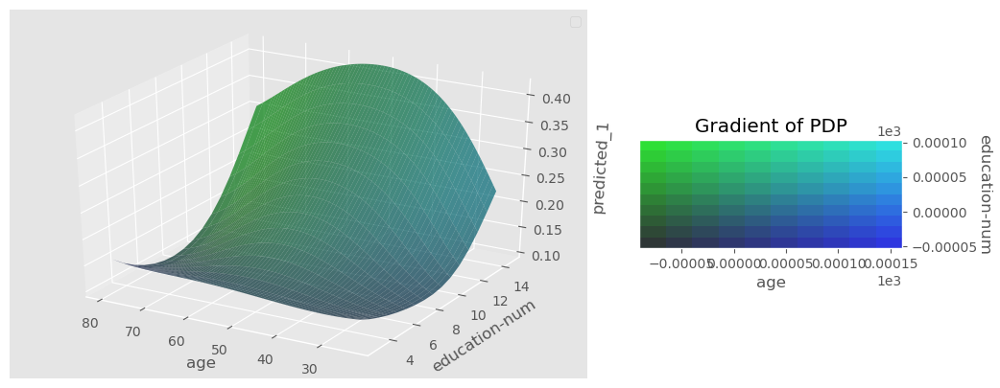

In [45]:
_ = generate_pdp_plots(PDPType.SKATER, model_4, "age", "education-num")

#### SHAP
 * Model 1 (Logistic Regression)

09-May-23 00:19:53 - Generating a PDP plot using SHAP for Model 1 ...


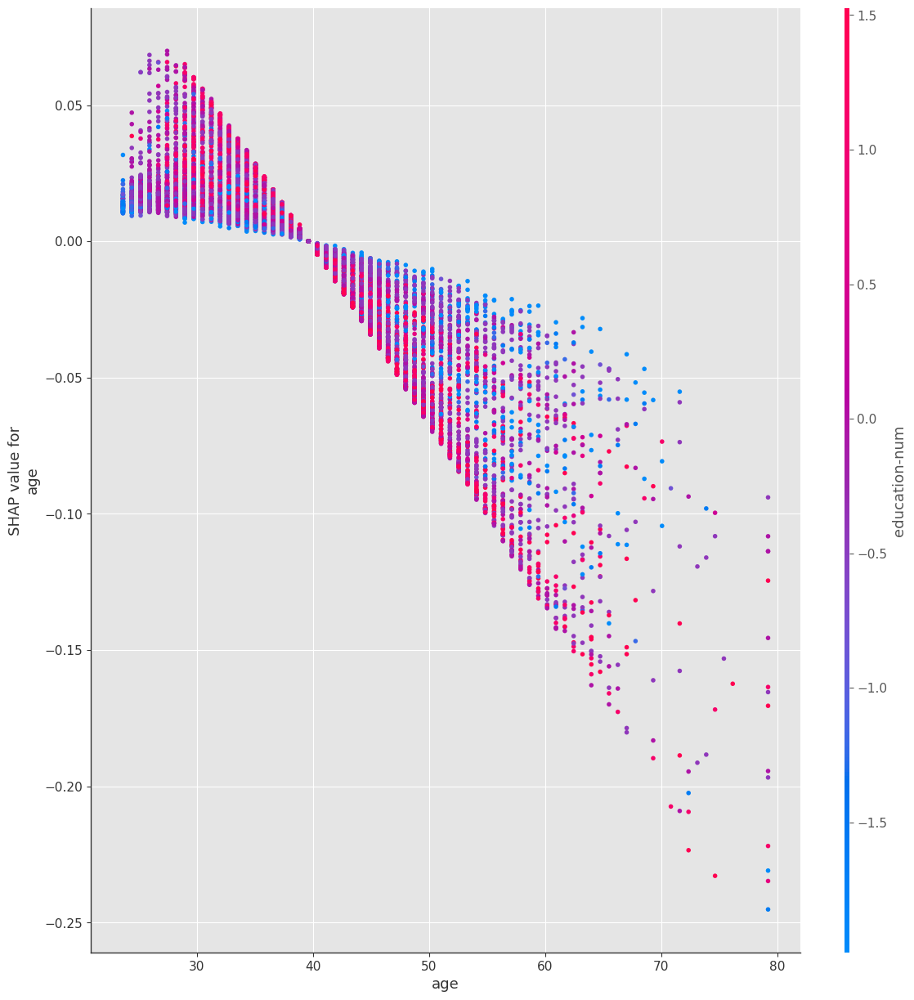

In [46]:
_ = generate_pdp_plots(PDPType.SHAP, model_1, "age", "education-num")

 * Model 2 (Decision Tree)

09-May-23 00:19:54 - Generating a PDP plot using SHAP for Model 2 ...


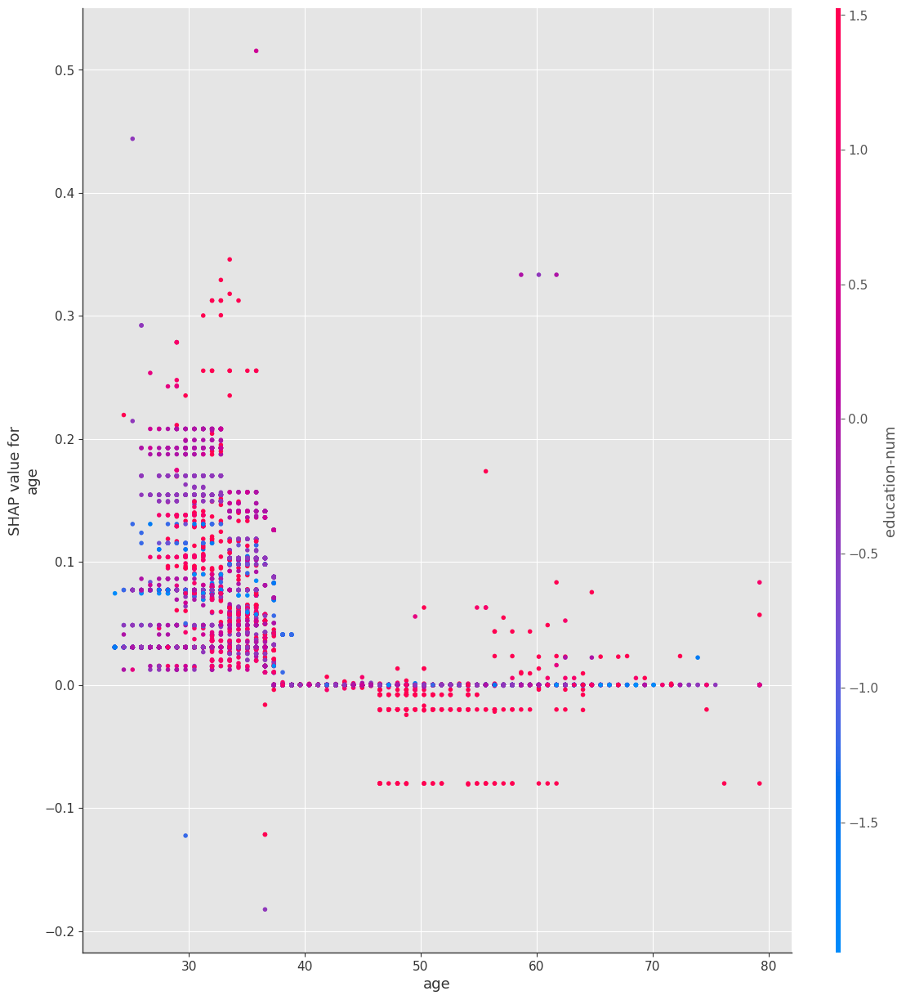

In [47]:
_ = generate_pdp_plots(PDPType.SHAP, model_2, "age", "education-num")

 * Model 3 (Random Forest)

09-May-23 00:19:54 - Generating a PDP plot using SHAP for Model 3 ...


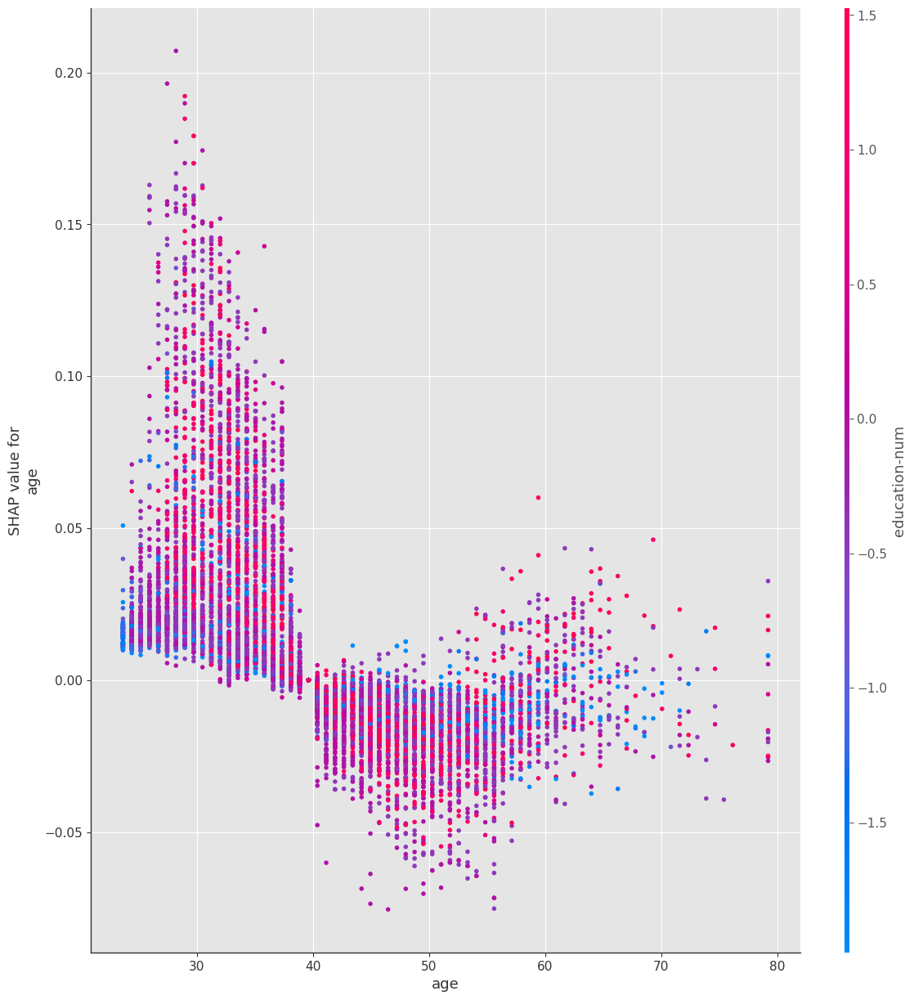

In [48]:
_ = generate_pdp_plots(PDPType.SHAP, model_3, "age", "education-num")

 * Model 4 (Support Vector Machine)

09-May-23 00:19:54 - Generating a PDP plot using SHAP for Model 4 ...


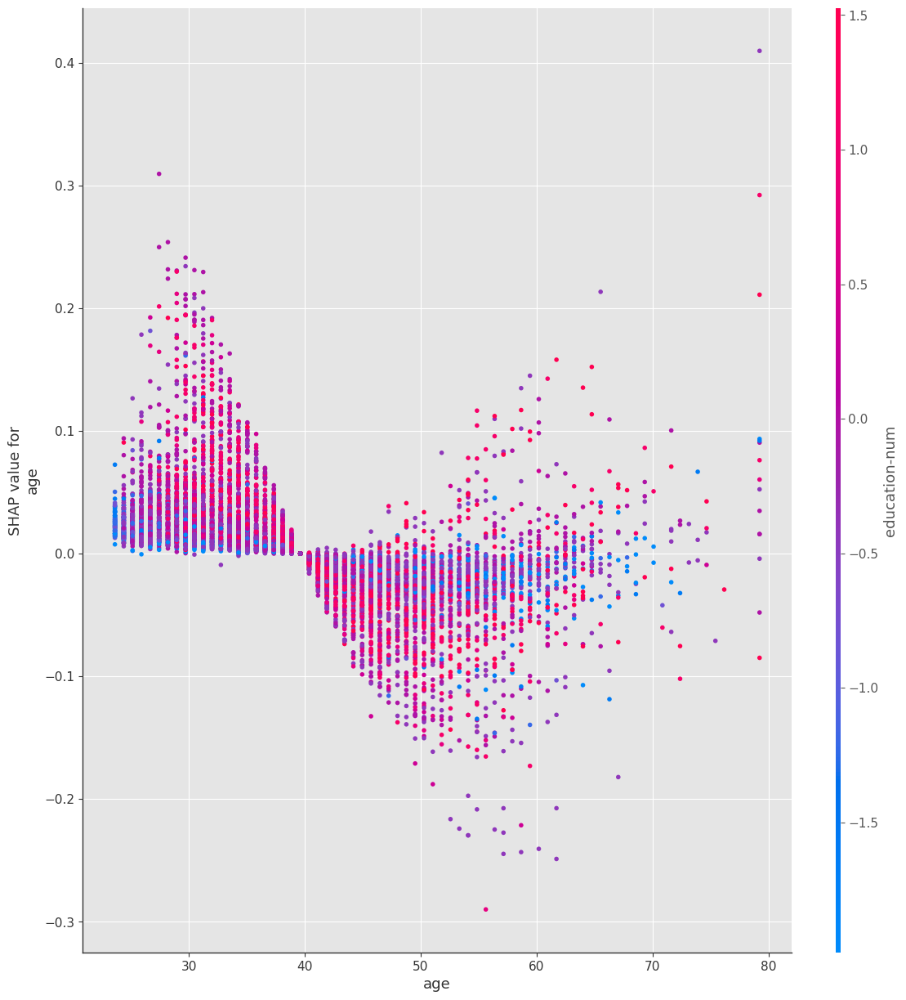

In [49]:
_ = generate_pdp_plots(PDPType.SHAP, model_4, "age", "education-num")

## Local model interpretations
Local interpretation focuses on specifics of each individual and provides explanations that can lead to a better understanding of the feature contribution in smaller groups of individuals that are often overlooked by the global interpretation techniques. We will use two moduels for interpreting single instances - SHAP and LIME.

#### SHAP
SHAP leverages the idea of Shapley values for model feature influence scoring. The technical definition of a Shapley value is the “average marginal contribution of a feature value over all possible coalitions.” In other words, Shapley values consider all possible predictions for an instance using all possible combinations of inputs. Because of this exhaustive approach, SHAP can guarantee properties like consistency and local accuracy. LIME, on the other hand, does not offer such guarantees.

#### LIME
[LIME](https://github.com/marcotcr/lime) (Local Interpretable Model-agnostic Explanations) builds sparse linear models around each prediction to explain how the black box model works in that local vicinity. While treating the model as a black box, we perturb the instance we want to explain and learn a sparse linear model around it, as an explanation. LIME has the advantage over *SHAP*, that it is a lot faster.



In [50]:
examples = []
example_types = [ExampleType.FALSELY_CLASSIFIED]
for example_type in example_types:
    for model in models:
        example = get_test_examples(model, example_type, 1)[0]
        while example in examples:
            example = get_test_examples(model, example_type, 1)[0]
        examples.append(example)
display(examples)

[5706, 7522, 6317, 8151]

##### Example 1

In [51]:
example = examples[0]
print(get_example_information(model_1, example))
print(generate_single_instance_comparison(models, example))

Example 5706's data: 
age                                37
workclass                   Local-gov
education                  Assoc-acdm
education-num                      12
marital-status     Married-civ-spouse
occupation             Prof-specialty
relationship                  Husband
ethnicity                       White
gender                           Male
capital-gain                        0
capital-loss                        0
hours-per-week                     45
Name: 9242, dtype: object
Actual result for example 5706:  >50K

Example 5706 was truly classified by Model 2, Model 3, Model 4 and falsely classified by Model 1.
 For further clarification see the explanations below.



 * Model 1 (Logistic Regression)

In [52]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_1, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_1, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, example))

09-May-23 00:20:00 - Generating a single instance explanation using OPTIMIZED_LIME for Model 1 ...
09-May-23 00:20:00 - Initializing LIME - generating new explainer for example 5706 and optimizing the kernel width. This operation may be time-consuming so please be patient.
09-May-23 00:27:46 - The optimal kernel width for example 5706 and Model 1 is 2.3357142857142854.
Variables Stability Index (VSI): 94.67
Coefficients Stability Index (CSI): 100.0


09-May-23 00:27:54 - Generating a single instance explanation using SHAP for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.52. LIME's explanation: 
The most impactful feature for Model 1's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.1978.
The 2nd most impactful feature for Model 1's positive (1) prediction probability is gender= Male with value of 0.083.
The 3rd most impactful feature for Model 1's positive (1) prediction probability is occupation= Prof-specialty with value of 0.0543.
The 4th most impactful feature for Model 1's positive (1) prediction probability is 10.00 < education-num <= 12.00 with value of 0.0504.
The 5th most impactful feature for Model 1's positive (1) prediction probability is ethnicity= White with value of 0.0207.
The 6th most impactful feature for Model 1's positive (1) prediction probability is 40.00 < hours-per-week <= 45.00 with value of 0.018.
The 7th most impactful feature for Model 1's positive (1) prediction probability is relationship= Husband with value of

The prediction probability of Model 1's decision for this example is 0.52. SHAP's explanation: 
The most impactful feature for Model 1's positive (1) prediction probability is capital-gain = 0 (-0.14534103649411262) with value of 0.0563.
The 2nd most impactful feature for Model 1's positive (1) prediction probability is education_ Assoc-acdm = 1 with value of 0.0443.
The 3rd most impactful feature for Model 1's positive (1) prediction probability is workclass_ Private = 0 with value of 0.0283.
The 4th most impactful feature for Model 1's positive (1) prediction probability is relationship_ Husband = 1 with value of 0.0067.
The 5th most impactful feature for Model 1's positive (1) prediction probability is age = 37 (-0.11410302447896853) with value of 0.0046.
The most impactful feature for Model 1's negative (0) prediction probability is marital-status_ Married-civ-spouse = 1 with value of -0.2515.
The 2nd most impactful feature for Model 1's negative (0) prediction probability is occup

 * Model 2 (Decision Tree)

In [53]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_2, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_2, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, example))

09-May-23 00:27:54 - Generating a single instance explanation using OPTIMIZED_LIME for Model 2 ...
09-May-23 00:27:54 - Initializing LIME - generating new explainer for example 5706 and optimizing the kernel width. This operation may be time-consuming so please be patient.
09-May-23 00:35:47 - The optimal kernel width for example 5706 and Model 2 is 2.9255102040816325.
Variables Stability Index (VSI): 97.22
Coefficients Stability Index (CSI): 89.78


09-May-23 00:35:55 - Generating a single instance explanation using SHAP for Model 2 ...


The prediction probability of Model 2's decision for this example is 0.56. LIME's explanation: 
The most impactful feature for Model 2's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.1894.
The 2nd most impactful feature for Model 2's positive (1) prediction probability is 40.00 < hours-per-week <= 45.00 with value of 0.0488.
The 3rd most impactful feature for Model 2's positive (1) prediction probability is occupation= Prof-specialty with value of 0.0252.
The 4th most impactful feature for Model 2's positive (1) prediction probability is gender= Male with value of 0.0112.
The 5th most impactful feature for Model 2's positive (1) prediction probability is 10.00 < education-num <= 12.00 with value of 0.0047.
The 6th most impactful feature for Model 2's positive (1) prediction probability is workclass= Local-gov with value of 0.0045.
The most impactful feature for Model 2's negative (0) prediction probability is capital-gain <= 0.00 with value o

The prediction probability of Model 2's decision for this example is 0.56. SHAP's explanation: 
The most impactful feature for Model 2's positive (1) prediction probability is marital-status_ Married-civ-spouse = 1 with value of 0.4238.
The 2nd most impactful feature for Model 2's positive (1) prediction probability is hours-per-week = 45 (0.34473841473322936) with value of 0.0559.
The 3rd most impactful feature for Model 2's positive (1) prediction probability is education-num = 12 (0.7465408896149263) with value of 0.0453.




 * Model 3 (Random Forest)

In [54]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_3, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_3, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, example))

09-May-23 00:35:55 - Generating a single instance explanation using OPTIMIZED_LIME for Model 3 ...
09-May-23 00:35:55 - Initializing LIME - generating new explainer for example 5706 and optimizing the kernel width. This operation may be time-consuming so please be patient.
09-May-23 01:11:31 - The optimal kernel width for example 5706 and Model 3 is 6.51734693877551.
Variables Stability Index (VSI): 93.11
Coefficients Stability Index (CSI): 96.0


09-May-23 01:12:09 - Generating a single instance explanation using SHAP for Model 3 ...


The prediction probability of Model 3's decision for this example is 0.53. LIME's explanation: 
The most impactful feature for Model 3's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.1425.
The 2nd most impactful feature for Model 3's positive (1) prediction probability is relationship= Husband with value of 0.063.
The 3rd most impactful feature for Model 3's positive (1) prediction probability is occupation= Prof-specialty with value of 0.0516.
The 4th most impactful feature for Model 3's positive (1) prediction probability is 40.00 < hours-per-week <= 45.00 with value of 0.0425.
The 5th most impactful feature for Model 3's positive (1) prediction probability is gender= Male with value of 0.0166.
The 6th most impactful feature for Model 3's positive (1) prediction probability is ethnicity= White with value of 0.0096.
The 7th most impactful feature for Model 3's positive (1) prediction probability is workclass= Local-gov with value of 0.0065.


The prediction probability of Model 3's decision for this example is 0.53. SHAP's explanation: 
The most impactful feature for Model 3's positive (1) prediction probability is marital-status_ Married-civ-spouse = 1 with value of 0.2224.
The 2nd most impactful feature for Model 3's positive (1) prediction probability is relationship_ Husband = 1 with value of 0.1035.
The 3rd most impactful feature for Model 3's positive (1) prediction probability is occupation_ Prof-specialty = 1 with value of 0.0806.
The 4th most impactful feature for Model 3's positive (1) prediction probability is hours-per-week = 45 (0.34473841473322936) with value of 0.0227.
The 5th most impactful feature for Model 3's positive (1) prediction probability is education-num = 12 (0.7465408896149263) with value of 0.016.
The 6th most impactful feature for Model 3's positive (1) prediction probability is workclass_ Local-gov = 1 with value of 0.0072.
The 7th most impactful feature for Model 3's positive (1) prediction p

 * Model 4 (Support Vector Machine)

In [55]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_4, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_4, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_4, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_4, example))

09-May-23 01:12:15 - Generating a single instance explanation using OPTIMIZED_LIME for Model 4 ...
09-May-23 01:12:15 - Initializing LIME - generating new explainer for example 5706 and optimizing the kernel width. This operation may be time-consuming so please be patient.
09-May-23 01:41:18 - The optimal kernel width for example 5706 and Model 4 is 5.237755102040817.
Variables Stability Index (VSI): 88.89
Coefficients Stability Index (CSI): 100.0


09-May-23 01:41:51 - Generating a single instance explanation using SHAP for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.52. LIME's explanation: 
The most impactful feature for Model 4's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.1002.
The 2nd most impactful feature for Model 4's positive (1) prediction probability is occupation= Prof-specialty with value of 0.0433.
The 3rd most impactful feature for Model 4's positive (1) prediction probability is 40.00 < hours-per-week <= 45.00 with value of 0.0328.
The 4th most impactful feature for Model 4's positive (1) prediction probability is gender= Male with value of 0.0309.
The 5th most impactful feature for Model 4's positive (1) prediction probability is 10.00 < education-num <= 12.00 with value of 0.0199.
The 6th most impactful feature for Model 4's positive (1) prediction probability is ethnicity= White with value of 0.01.
The 7th most impactful feature for Model 4's positive (1) prediction probability is relationship= Husband with value of

The prediction probability of Model 4's decision for this example is 0.52. SHAP's explanation: 
The most impactful feature for Model 4's positive (1) prediction probability is marital-status_ Married-civ-spouse = 1 with value of 0.2702.
The 2nd most impactful feature for Model 4's positive (1) prediction probability is occupation_ Prof-specialty = 1 with value of 0.2056.
The 3rd most impactful feature for Model 4's positive (1) prediction probability is education-num = 12 (0.7465408896149263) with value of 0.0779.
The 4th most impactful feature for Model 4's positive (1) prediction probability is hours-per-week = 45 (0.34473841473322936) with value of 0.0149.
The most impactful feature for Model 4's negative (0) prediction probability is education_ Assoc-acdm = 1 with value of -0.0373.
The 2nd most impactful feature for Model 4's negative (0) prediction probability is relationship_ Husband = 1 with value of -0.0316.
The 3rd most impactful feature for Model 4's negative (0) prediction p

##### Example 2

In [56]:
example = examples[1]
print(get_example_information(model_1, example))
print(generate_single_instance_comparison(models, example))

Example 7522's data: 
age                                46
workclass                     Private
education                Some-college
education-num                      10
marital-status     Married-civ-spouse
occupation               Tech-support
relationship                  Husband
ethnicity                       White
gender                           Male
capital-gain                        0
capital-loss                     1887
hours-per-week                     45
Name: 6989, dtype: object
Actual result for example 7522:  >50K

Example 7522 was truly classified by Model 1, Model 4 and falsely classified by Model 2, Model 3.
 For further clarification see the explanations below.



 * Model 1 (Logistic Regression)

In [57]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_1, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_1, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, example))

09-May-23 01:41:57 - Generating a single instance explanation using OPTIMIZED_LIME for Model 1 ...
09-May-23 01:41:57 - Initializing LIME - generating new explainer for example 7522 and optimizing the kernel width. This operation may be time-consuming so please be patient.
09-May-23 01:49:17 - The optimal kernel width for example 7522 and Model 1 is 1.2928571428571427.
Variables Stability Index (VSI): 91.56
Coefficients Stability Index (CSI): 100.0


09-May-23 01:49:25 - Generating a single instance explanation using SHAP for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.77. LIME's explanation: 
The most impactful feature for Model 1's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.208.
The 2nd most impactful feature for Model 1's positive (1) prediction probability is capital-loss > 0.00 with value of 0.1352.
The 3rd most impactful feature for Model 1's positive (1) prediction probability is gender= Male with value of 0.09.
The 4th most impactful feature for Model 1's positive (1) prediction probability is occupation= Tech-support with value of 0.0772.
The 5th most impactful feature for Model 1's positive (1) prediction probability is ethnicity= White with value of 0.0227.
The 6th most impactful feature for Model 1's positive (1) prediction probability is 40.00 < hours-per-week <= 45.00 with value of 0.0185.
The 7th most impactful feature for Model 1's positive (1) prediction probability is workclass= Private with value of 0.0138.
The 8th 

The prediction probability of Model 1's decision for this example is 0.77. SHAP's explanation: 
The most impactful feature for Model 1's positive (1) prediction probability is marital-status_ Married-civ-spouse = 1 with value of 0.282.
The 2nd most impactful feature for Model 1's positive (1) prediction probability is capital-loss = 1886 (4.227206410060442) with value of 0.2219.
The 3rd most impactful feature for Model 1's positive (1) prediction probability is occupation_ Tech-support = 1 with value of 0.1425.
The 4th most impactful feature for Model 1's positive (1) prediction probability is age = 46 (0.5711099253026403) with value of 0.0382.
The 5th most impactful feature for Model 1's positive (1) prediction probability is hours-per-week = 45 (0.34473841473322936) with value of 0.0223.
The 6th most impactful feature for Model 1's positive (1) prediction probability is education_ Some-college = 1 with value of 0.0144.
The most impactful feature for Model 1's negative (0) prediction 

 * Model 2 (Decision Tree)

In [58]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_2, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_2, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, example))

09-May-23 01:49:25 - Generating a single instance explanation using OPTIMIZED_LIME for Model 2 ...
09-May-23 01:49:25 - Initializing LIME - generating new explainer for example 7522 and optimizing the kernel width. This operation may be time-consuming so please be patient.
09-May-23 01:57:09 - The optimal kernel width for example 7522 and Model 2 is 1.9459183673469385.
Variables Stability Index (VSI): 94.82
Coefficients Stability Index (CSI): 81.78


09-May-23 01:57:17 - Generating a single instance explanation using SHAP for Model 2 ...


The prediction probability of Model 2's decision for this example is 0.53. LIME's explanation: 
The most impactful feature for Model 2's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.1902.
The 2nd most impactful feature for Model 2's positive (1) prediction probability is capital-loss > 0.00 with value of 0.0917.
The 3rd most impactful feature for Model 2's positive (1) prediction probability is occupation= Tech-support with value of 0.074.
The 4th most impactful feature for Model 2's positive (1) prediction probability is 37.00 < age <= 47.00 with value of 0.0719.
The 5th most impactful feature for Model 2's positive (1) prediction probability is 40.00 < hours-per-week <= 45.00 with value of 0.0485.
The 6th most impactful feature for Model 2's positive (1) prediction probability is gender= Male with value of 0.0121.
The most impactful feature for Model 2's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.5062.
The

The prediction probability of Model 2's decision for this example is 0.53. SHAP's explanation: 
The most impactful feature for Model 2's negative (0) prediction probability is marital-status_ Married-civ-spouse = 1 with value of -0.3785.
The 2nd most impactful feature for Model 2's negative (0) prediction probability is hours-per-week = 45 (0.34473841473322936) with value of -0.0559.




 * Model 3 (Random Forest)

In [59]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_3, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_3, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, example))

09-May-23 01:57:17 - Generating a single instance explanation using OPTIMIZED_LIME for Model 3 ...
09-May-23 01:57:17 - Initializing LIME - generating new explainer for example 7522 and optimizing the kernel width. This operation may be time-consuming so please be patient.
09-May-23 02:31:11 - The optimal kernel width for example 7522 and Model 3 is 1.1928571428571426.
Variables Stability Index (VSI): 88.89
Coefficients Stability Index (CSI): 100.0


09-May-23 02:31:50 - Generating a single instance explanation using SHAP for Model 3 ...


The prediction probability of Model 3's decision for this example is 0.55. LIME's explanation: 
The most impactful feature for Model 3's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.1462.
The 2nd most impactful feature for Model 3's positive (1) prediction probability is capital-loss > 0.00 with value of 0.0676.
The 3rd most impactful feature for Model 3's positive (1) prediction probability is relationship= Husband with value of 0.0634.
The 4th most impactful feature for Model 3's positive (1) prediction probability is 37.00 < age <= 47.00 with value of 0.0533.
The 5th most impactful feature for Model 3's positive (1) prediction probability is occupation= Tech-support with value of 0.0479.
The 6th most impactful feature for Model 3's positive (1) prediction probability is 40.00 < hours-per-week <= 45.00 with value of 0.0457.
The 7th most impactful feature for Model 3's positive (1) prediction probability is gender= Male with value of 0.0175

The prediction probability of Model 3's decision for this example is 0.55. SHAP's explanation: 
The most impactful feature for Model 3's positive (1) prediction probability is capital-loss = 1886 (4.227206410060442) with value of 0.0618.
The most impactful feature for Model 3's negative (0) prediction probability is marital-status_ Married-civ-spouse = 1 with value of -0.191.
The 2nd most impactful feature for Model 3's negative (0) prediction probability is occupation_ Tech-support = 1 with value of -0.1058.
The 3rd most impactful feature for Model 3's negative (0) prediction probability is relationship_ Husband = 1 with value of -0.0879.
The 4th most impactful feature for Model 3's negative (0) prediction probability is age = 46 (0.5711099253026403) with value of -0.0252.
The 5th most impactful feature for Model 3's negative (0) prediction probability is education_ Some-college = 1 with value of -0.0221.
The 6th most impactful feature for Model 3's negative (0) prediction probability

 * Model 4 (Support Vector Machine)

In [60]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_4, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_4, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_4, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_4, example))

09-May-23 02:31:56 - Generating a single instance explanation using OPTIMIZED_LIME for Model 4 ...
09-May-23 02:31:56 - Initializing LIME - generating new explainer for example 7522 and optimizing the kernel width. This operation may be time-consuming so please be patient.
09-May-23 03:01:02 - The optimal kernel width for example 7522 and Model 4 is 2.6785714285714284.
Variables Stability Index (VSI): 89.63
Coefficients Stability Index (CSI): 88.0


09-May-23 03:01:34 - Generating a single instance explanation using SHAP for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.88. LIME's explanation: 
The most impactful feature for Model 4's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.102.
The 2nd most impactful feature for Model 4's positive (1) prediction probability is capital-loss > 0.00 with value of 0.0948.
The 3rd most impactful feature for Model 4's positive (1) prediction probability is occupation= Tech-support with value of 0.0879.
The 4th most impactful feature for Model 4's positive (1) prediction probability is 37.00 < age <= 47.00 with value of 0.0407.
The 5th most impactful feature for Model 4's positive (1) prediction probability is 40.00 < hours-per-week <= 45.00 with value of 0.0335.
The 6th most impactful feature for Model 4's positive (1) prediction probability is gender= Male with value of 0.0319.
The 7th most impactful feature for Model 4's positive (1) prediction probability is ethnicity= White with value of 0.0104.
The 

The prediction probability of Model 4's decision for this example is 0.88. SHAP's explanation: 
The most impactful feature for Model 4's positive (1) prediction probability is marital-status_ Married-civ-spouse = 1 with value of 0.2187.
The 2nd most impactful feature for Model 4's positive (1) prediction probability is occupation_ Tech-support = 1 with value of 0.2042.
The 3rd most impactful feature for Model 4's positive (1) prediction probability is capital-loss = 1886 (4.227206410060442) with value of 0.1928.
The 4th most impactful feature for Model 4's positive (1) prediction probability is age = 46 (0.5711099253026403) with value of 0.1045.
The 5th most impactful feature for Model 4's positive (1) prediction probability is relationship_ Husband = 1 with value of 0.0322.
The 6th most impactful feature for Model 4's positive (1) prediction probability is hours-per-week = 45 (0.34473841473322936) with value of 0.0204.
The 7th most impactful feature for Model 4's positive (1) predicti

##### Example 3

In [61]:
example = examples[2]
print(get_example_information(model_1, example))
print(generate_single_instance_comparison(models, example))

Example 6317's data: 
age                                37
workclass                     Private
education                     HS-grad
education-num                       9
marital-status     Married-civ-spouse
occupation            Exec-managerial
relationship                  Husband
ethnicity                       White
gender                           Male
capital-gain                        0
capital-loss                        0
hours-per-week                     55
Name: 7924, dtype: object
Actual result for example 6317:  <=50K

Example 6317 was truly classified by Model 1, Model 2 and falsely classified by Model 3, Model 4.
 For further clarification see the explanations below.



 * Model 1 (Logistic Regression)

In [62]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_1, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_1, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, example))

09-May-23 03:01:41 - Generating a single instance explanation using OPTIMIZED_LIME for Model 1 ...
09-May-23 03:01:41 - Initializing LIME - generating new explainer for example 6317 and optimizing the kernel width. This operation may be time-consuming so please be patient.
09-May-23 03:09:23 - The optimal kernel width for example 6317 and Model 1 is 1.9091836734693877.
Variables Stability Index (VSI): 89.78
Coefficients Stability Index (CSI): 100.0


09-May-23 03:09:31 - Generating a single instance explanation using SHAP for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.51. LIME's explanation: 
The most impactful feature for Model 1's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.1973.
The 2nd most impactful feature for Model 1's positive (1) prediction probability is occupation= Exec-managerial with value of 0.0856.
The 3rd most impactful feature for Model 1's positive (1) prediction probability is hours-per-week > 45.00 with value of 0.0849.
The 4th most impactful feature for Model 1's positive (1) prediction probability is gender= Male with value of 0.0805.
The 5th most impactful feature for Model 1's positive (1) prediction probability is ethnicity= White with value of 0.0203.
The 6th most impactful feature for Model 1's positive (1) prediction probability is workclass= Private with value of 0.0108.
The 7th most impactful feature for Model 1's positive (1) prediction probability is education= HS-grad with value of 0.0089.
The 8th most

The prediction probability of Model 1's decision for this example is 0.51. SHAP's explanation: 
The most impactful feature for Model 1's positive (1) prediction probability is capital-gain = 0 (-0.14534103649411262) with value of 0.0565.
The 2nd most impactful feature for Model 1's positive (1) prediction probability is education-num = 9 (-0.4234150403291547) with value of 0.0541.
The 3rd most impactful feature for Model 1's positive (1) prediction probability is relationship_ Husband = 1 with value of 0.0067.
The 4th most impactful feature for Model 1's positive (1) prediction probability is age = 37 (-0.11410302447896853) with value of 0.0046.
The most impactful feature for Model 1's negative (0) prediction probability is marital-status_ Married-civ-spouse = 1 with value of -0.2539.
The 2nd most impactful feature for Model 1's negative (0) prediction probability is occupation_ Exec-managerial = 1 with value of -0.1618.
The 3rd most impactful feature for Model 1's negative (0) predict

 * Model 2 (Decision Tree)

In [63]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_2, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_2, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, example))

09-May-23 03:09:31 - Generating a single instance explanation using OPTIMIZED_LIME for Model 2 ...
09-May-23 03:09:31 - Initializing LIME - generating new explainer for example 6317 and optimizing the kernel width. This operation may be time-consuming so please be patient.
09-May-23 03:17:15 - The optimal kernel width for example 6317 and Model 2 is 1.6193877551020406.
Variables Stability Index (VSI): 92.89
Coefficients Stability Index (CSI): 100.0


09-May-23 03:17:23 - Generating a single instance explanation using SHAP for Model 2 ...


The prediction probability of Model 2's decision for this example is 0.64. LIME's explanation: 
The most impactful feature for Model 2's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.182.
The 2nd most impactful feature for Model 2's positive (1) prediction probability is hours-per-week > 45.00 with value of 0.0592.
The 3rd most impactful feature for Model 2's positive (1) prediction probability is occupation= Exec-managerial with value of 0.0251.
The 4th most impactful feature for Model 2's positive (1) prediction probability is gender= Male with value of 0.0094.
The most impactful feature for Model 2's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.518.
The 2nd most impactful feature for Model 2's negative (0) prediction probability is education-num <= 9.00 with value of -0.1447.
The 3rd most impactful feature for Model 2's negative (0) prediction probability is capital-loss <= 0.00 with value of -0.0958.
The 4t

The prediction probability of Model 2's decision for this example is 0.64. SHAP's explanation: 
The most impactful feature for Model 2's positive (1) prediction probability is education-num = 9 (-0.4234150403291547) with value of 0.0572.
The most impactful feature for Model 2's negative (0) prediction probability is marital-status_ Married-civ-spouse = 1 with value of -0.3213.
The 2nd most impactful feature for Model 2's negative (0) prediction probability is hours-per-week = 55 (1.1837563538837934) with value of -0.0559.




 * Model 3 (Random Forest)

In [64]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_3, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_3, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, example))

09-May-23 03:17:23 - Generating a single instance explanation using OPTIMIZED_LIME for Model 3 ...
09-May-23 03:17:23 - Initializing LIME - generating new explainer for example 6317 and optimizing the kernel width. This operation may be time-consuming so please be patient.
09-May-23 03:53:09 - The optimal kernel width for example 6317 and Model 3 is 2.498076211353316.
Variables Stability Index (VSI): 91.56
Coefficients Stability Index (CSI): 100.0


09-May-23 03:53:48 - Generating a single instance explanation using SHAP for Model 3 ...


The prediction probability of Model 3's decision for this example is 0.59. LIME's explanation: 
The most impactful feature for Model 3's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.1418.
The 2nd most impactful feature for Model 3's positive (1) prediction probability is occupation= Exec-managerial with value of 0.0764.
The 3rd most impactful feature for Model 3's positive (1) prediction probability is hours-per-week > 45.00 with value of 0.0725.
The 4th most impactful feature for Model 3's positive (1) prediction probability is relationship= Husband with value of 0.0616.
The 5th most impactful feature for Model 3's positive (1) prediction probability is gender= Male with value of 0.0152.
The 6th most impactful feature for Model 3's positive (1) prediction probability is ethnicity= White with value of 0.0095.
The most impactful feature for Model 3's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.4728.
The 2nd mo

The prediction probability of Model 3's decision for this example is 0.59. SHAP's explanation: 
The most impactful feature for Model 3's positive (1) prediction probability is marital-status_ Married-civ-spouse = 1 with value of 0.2354.
The 2nd most impactful feature for Model 3's positive (1) prediction probability is occupation_ Exec-managerial = 1 with value of 0.144.
The 3rd most impactful feature for Model 3's positive (1) prediction probability is relationship_ Husband = 1 with value of 0.1175.
The 4th most impactful feature for Model 3's positive (1) prediction probability is hours-per-week = 55 (1.1837563538837934) with value of 0.0591.
The 5th most impactful feature for Model 3's positive (1) prediction probability is capital-gain = 0 (-0.14534103649411262) with value of 0.0037.
The most impactful feature for Model 3's negative (0) prediction probability is education-num = 9 (-0.4234150403291547) with value of -0.0232.
The 2nd most impactful feature for Model 3's negative (0) 

 * Model 4 (Support Vector Machine)

In [65]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_4, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_4, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_4, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_4, example))

09-May-23 03:53:54 - Generating a single instance explanation using OPTIMIZED_LIME for Model 4 ...
09-May-23 03:53:54 - Initializing LIME - generating new explainer for example 6317 and optimizing the kernel width. This operation may be time-consuming so please be patient.
09-May-23 04:20:27 - The optimal kernel width for example 6317 and Model 4 is 1.1295918367346938.
Variables Stability Index (VSI): 88.45
Coefficients Stability Index (CSI): 100.0


09-May-23 04:20:59 - Generating a single instance explanation using SHAP for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.55. LIME's explanation: 
The most impactful feature for Model 4's positive (1) prediction probability is marital-status= Married-civ-spouse with value of 0.0976.
The 2nd most impactful feature for Model 4's positive (1) prediction probability is hours-per-week > 45.00 with value of 0.0651.
The 3rd most impactful feature for Model 4's positive (1) prediction probability is occupation= Exec-managerial with value of 0.0619.
The 4th most impactful feature for Model 4's positive (1) prediction probability is gender= Male with value of 0.0331.
The 5th most impactful feature for Model 4's positive (1) prediction probability is ethnicity= White with value of 0.0081.
The 6th most impactful feature for Model 4's positive (1) prediction probability is relationship= Husband with value of 0.0062.
The most impactful feature for Model 4's negative (0) prediction probability is capital-gain <= 0.00 with value of -0.5649.
The 2nd mo

The prediction probability of Model 4's decision for this example is 0.55. SHAP's explanation: 
The most impactful feature for Model 4's positive (1) prediction probability is occupation_ Exec-managerial = 1 with value of 0.2423.
The 2nd most impactful feature for Model 4's positive (1) prediction probability is marital-status_ Married-civ-spouse = 1 with value of 0.1797.
The 3rd most impactful feature for Model 4's positive (1) prediction probability is hours-per-week = 55 (1.1837563538837934) with value of 0.0705.
The 4th most impactful feature for Model 4's positive (1) prediction probability is education_ HS-grad = 1 with value of 0.023.
The 5th most impactful feature for Model 4's positive (1) prediction probability is capital-gain = 0 (-0.14534103649411262) with value of 0.0183.
The 6th most impactful feature for Model 4's positive (1) prediction probability is relationship_ Husband = 1 with value of 0.003.
The most impactful feature for Model 4's negative (0) prediction probabil

##### Example 4

In [66]:
example = examples[3]
print(get_example_information(model_1, example))
print(generate_single_instance_comparison(models, example))

Example 8151's data: 
age                                   56
workclass               Self-emp-not-inc
education                      Bachelors
education-num                         13
marital-status     Married-spouse-absent
occupation                Prof-specialty
relationship               Not-in-family
ethnicity                          White
gender                            Female
capital-gain                           0
capital-loss                           0
hours-per-week                        40
Name: 14484, dtype: object
Actual result for example 8151:  >50K

Example 8151 was truly classified by no model and falsely classified by Model 1, Model 2, Model 3, Model 4.
 For further clarification see the explanations below.



 * Model 1 (Logistic Regression)

In [67]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_1, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_1, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, example))

09-May-23 04:21:05 - Generating a single instance explanation using OPTIMIZED_LIME for Model 1 ...
09-May-23 04:21:05 - Initializing LIME - generating new explainer for example 8151 and optimizing the kernel width. This operation may be time-consuming so please be patient.


ValueError: cannot convert float NaN to integer

 * Model 2 (Decision Tree)

In [ ]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_2, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_2, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, example))

 * Model 3 (Random Forest)

In [ ]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_3, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_3, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, example))

 * Model 4 (Support Vector Machine)

In [ ]:
# LIME
explanation = explain_single_instance(LocalInterpreterType.OPTIMIZED_LIME, model_4, example)
explanation.show_in_notebook(show_table=True, show_all=True)
print(generate_single_instance_explanation(LocalInterpreterType.OPTIMIZED_LIME, model_4, example))

# SHAP
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_4, example)
display(explanation)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_4, example))